In [ ]:
!pip install pip
!pip install lxml
import pip

for each in ["requests","beautifulsoup4"]: 
    pip.main(['install', each])

import requests
from bs4 import BeautifulSoup


!pip install Corpora
import nltk
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')
nltk.download('omw-1.4')

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Please see https://github.com/pypa/pip/issues/5599 for advice on fixing the underlying issue.
To avoid this problem you can invoke Python with '-m pip' instead of running pip directly.


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Please see https://github.com/pypa/pip/issues/5599 for advice on fixing the underlying issue.
To avoid this problem you can invoke Python with '-m pip' instead of running pip directly.


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [143]:
import numpy as np 
import pandas as pd 
import string
from textblob import TextBlob
from nltk.corpus import stopwords
from nltk.corpus import wordnet

from sklearn.naive_bayes import MultinomialNB
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from wordcloud import WordCloud

import matplotlib.pyplot as plt
%matplotlib inline
from textblob import Word
from textblob import TextBlob, Word, Blobber
from textblob.classifiers import NaiveBayesClassifier
from textblob.taggers import NLTKTagger

import sqlite3
import re


In [ ]:
job_df = pd.read_csv('/content/jobs_data.csv' , keep_default_na=False)

print("Raw Data")
print(job_df.head())

print("Data Shape")
print(job_df.shape)

Raw Data
   Unnamed: 0                            job_title  \
0           0            Data Scientist Internship   
1           1                Data Scientist Intern   
2           2  Data Scientist Internship - OR (US)   
3           3  Data Scientist Internship - ML (US)   
4           4       Data Scientist Intern (Remote)   

                                            industry  \
0                  Radio and Television Broadcasting   
1                                 Financial Services   
2                                          Insurance   
3                                          Insurance   
4  Appliances, Electrical, and Electronics Manufa...   

                                    company  \
0                               iHeartMedia   
1  Mercedes-Benz Financial Services USA LLC   
2                                   Asurion   
3                                   Asurion   
4                      Digi-Key Electronics   

                                         descr

In [ ]:
job_df.head()
job_df.drop(columns = job_df.columns[0], axis = 1, inplace= True)
job_df = job_df.dropna(how='all')

In [ ]:
## Lower case
job_df['description'] = job_df['description'].apply(lambda x: " ".join(x.lower()for x in x.split()))
## remove tabulation and punctuation
job_df['description'] = job_df['description'].str.replace('[^\w\s]',' ')


#remove stop words
stop = stopwords.words('english')
job_df['description'] = job_df['description'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))

## lemmatization
job_df['description'] = job_df['description'].apply(lambda x: " ".join([Word(word).lemmatize() for word in x.split()]))

print("Preprocessed data: \n")
print(job_df.head())

<ipython-input-88-de7a2d617795>:4: FutureWarning: The default value of regex will change from True to False in a future version.
  job_df['description'] = job_df['description'].str.replace('[^\w\s]',' ')


Preprocessed data: 

                             job_title  \
0            Data Scientist Internship   
1                Data Scientist Intern   
2  Data Scientist Internship - OR (US)   
3  Data Scientist Internship - ML (US)   
4       Data Scientist Intern (Remote)   

                                            industry  \
0                  Radio and Television Broadcasting   
1                                 Financial Services   
2                                          Insurance   
3                                          Insurance   
4  Appliances, Electrical, and Electronics Manufa...   

                                    company  \
0                               iHeartMedia   
1  Mercedes-Benz Financial Services USA LLC   
2                                   Asurion   
3                                   Asurion   
4                      Digi-Key Electronics   

                                         description      job_locality  \
0  iheartmediacurrent employee c

In [ ]:
## jda stands for job description aggregated
aggregate = job_df.groupby(['job_title']).sum().reset_index()
print("Aggregated JD")
print("\n\n")
print(aggregate)

Aggregated JD



                                             job_title  \
0          AWS Devops with EKS(10+years must) -Onsite    
1                                         DATA ANALYST   
2                            DevOps with Python/Pulumi   
3                                 Integration Engineer   
4                               Observability Engineer   
..                                                 ...   
908  Vehicle Hardware - Silicon Development Enginee...   
909                                      Web Developer   
910                 data scientist - multiple openings   
911                                 lulu devops engAWS   
912            software engineer II - Hybrid or Remote   

                                              industry  \
0                        IT Services and IT Consulting   
1                            Hospitals and Health Care   
2                        IT Services and IT Consulting   
3    Furniture and Home Furnishings Manufacturing,R...


***  AWS Devops with EKS(10+years must) -Onsite  ***



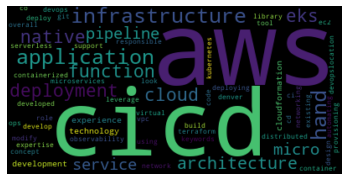


***  DATA ANALYST ***



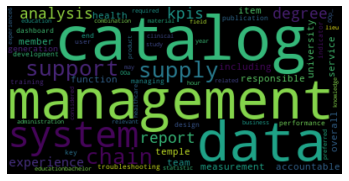


***  DevOps with Python/Pulumi ***



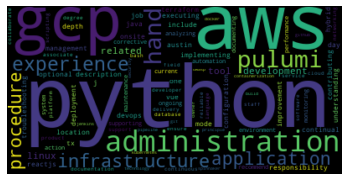


***  Integration Engineer ***



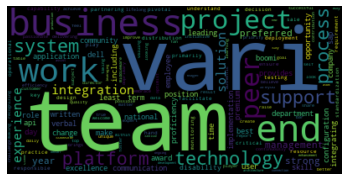


***  Observability Engineer ***



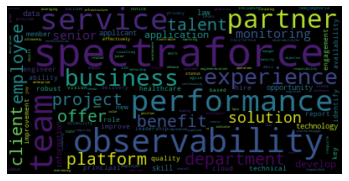


***  Software Engineer- Backend (Remote) ***



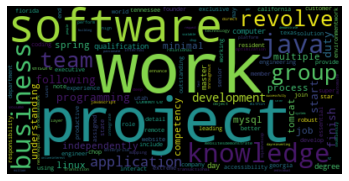


*** (Remote) Software Engineer ***



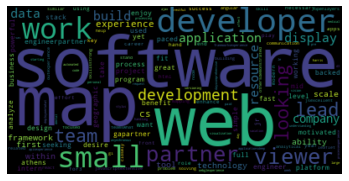


*** 2023 Intern - Software Developer ***



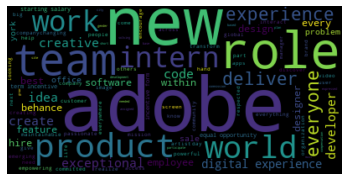


*** 2023 Intern - Software Engineer ***



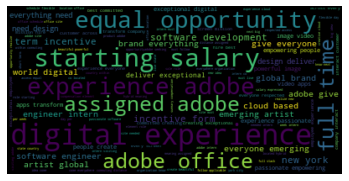


*** 2023 Intern - Software Engineer, Front End ***



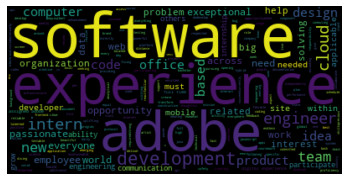


*** 2023 Intern - Software Engineer, Machine Learning ***



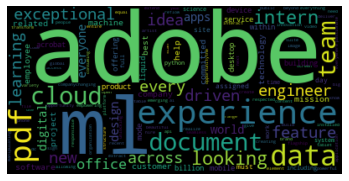


*** 2023 Intern - Software Engineer, Mobile Development ***



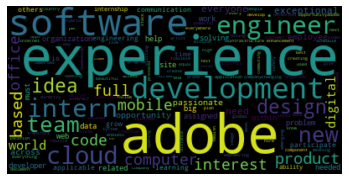


*** 2023 Internship – Cybersecurity/Software Engineering Intern ***



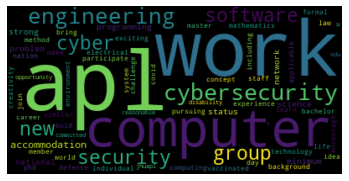


*** 2023 Internship: Data Scientist ***



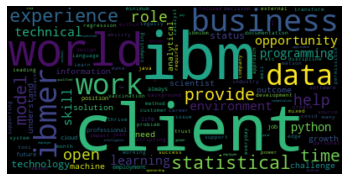


*** 2023 Software Engineer Internship ***



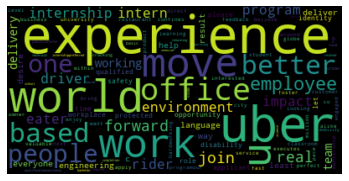


*** 2023 Summer Intern - Software Development ***



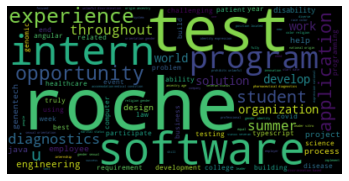


*** 2023 Summer Intern - Software Engineer [Slack] ***



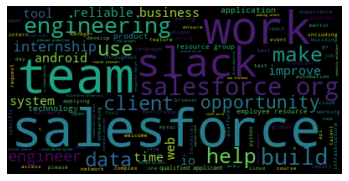


*** 2023 Summer Intern - Software Engineer, US ***



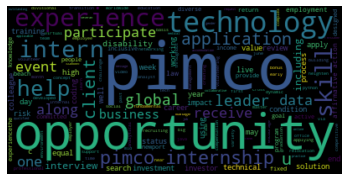


*** 2023 Summer Intern Program Opportunities ***



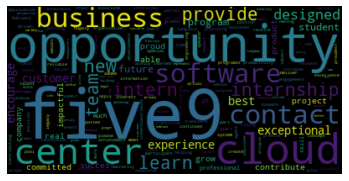


*** 2023 Summer Internship - Cloud Engineer Intern Job ***



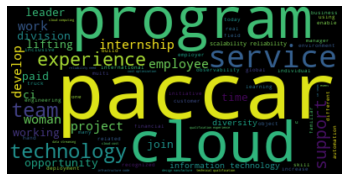


*** 2023 Summer Internship - Software Developer - Sales Tool Platform Intern Job ***



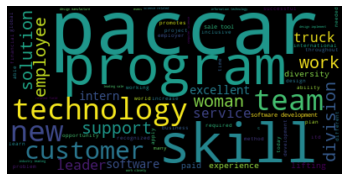


*** 2023 Summer Internship - Software Developer - Vehicle Software Delivery Intern Job ***



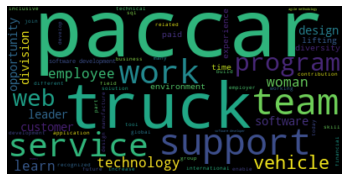


*** 2023 UberSTAR Internship Program - Data Science ***



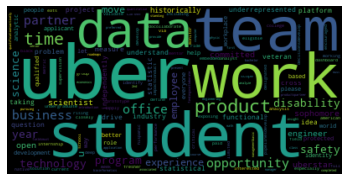


*** 2023 University Graduate - Data Scientist ***



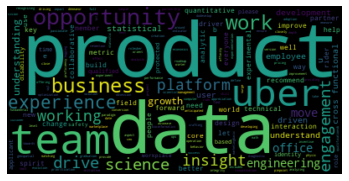


*** AWS Cloud Developer ***



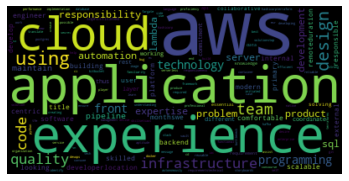


*** AWS Cloud Devops Lead Engineer ***



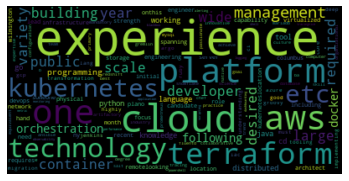


*** AWS Cloud Engineer ***



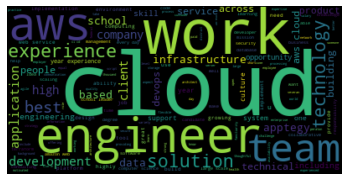


*** AWS Cloud Engineer (NO THIRD PARTIES) ***



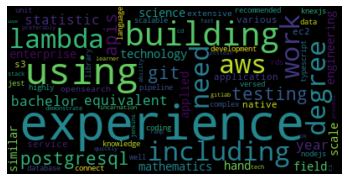


*** AWS Cloud Engineer - Remote ***



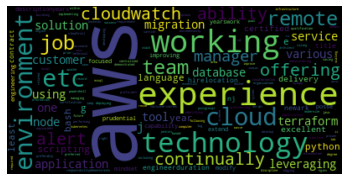


*** AWS Cloud Infrastructure Engineer  ***



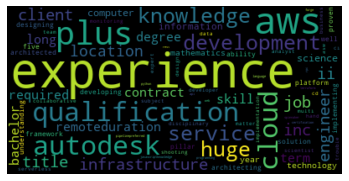


*** AWS DEVELOPER ***



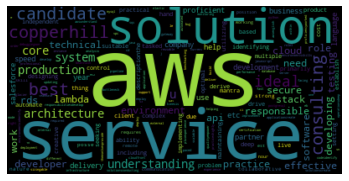


*** AWS Data Engineer ***



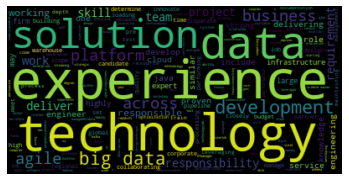


*** AWS Deployment Engineer ***



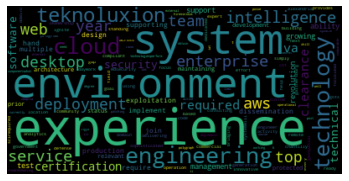


*** AWS DevOps Engineer II (Remote) ***



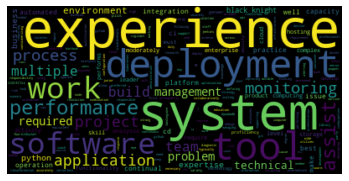


*** AWS DevOps SRE ***



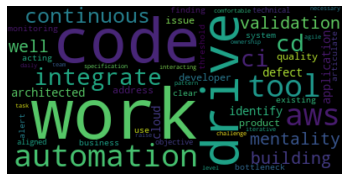


*** AWS DevOps with SRE ***



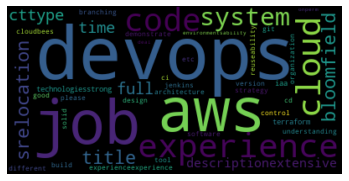


*** AWS Developer - III ***



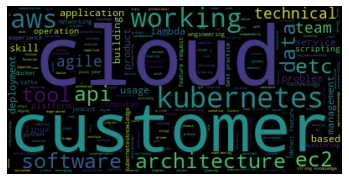


*** AWS Devops ***



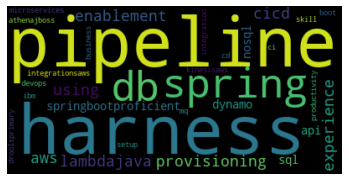


*** AWS Devops Engineer ***



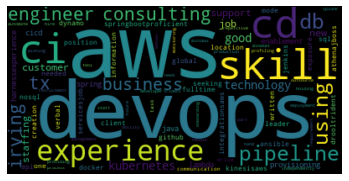


*** AWS Devops Integrator ***



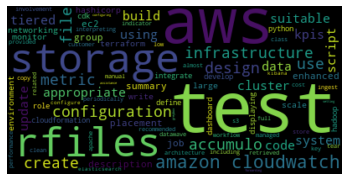


*** AWS Engineer/Architect with Data Center Migration -- 100% REMOTE ***



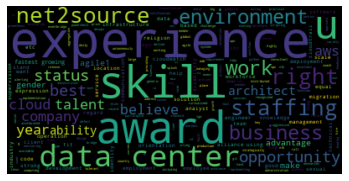


*** AWS Site Reliability Engineer ***



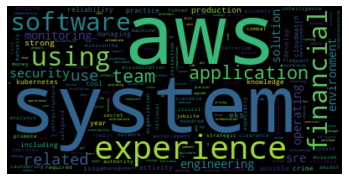


*** AWS SysOps Engineer ***



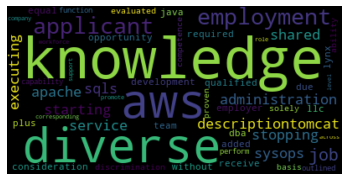


*** AZURE DEVOPS : Stamford CT ***



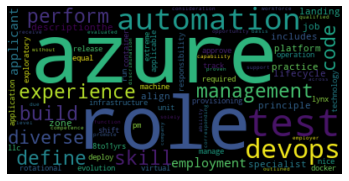


*** Acoustic Data Scientist ***



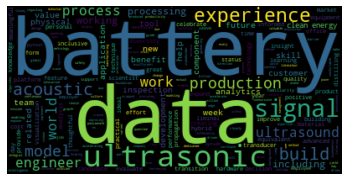


*** Actuarial Data Scientist ***



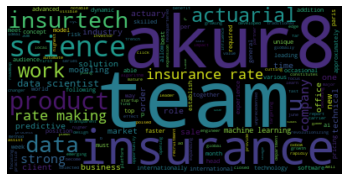


*** Adobe Data Analyst ***



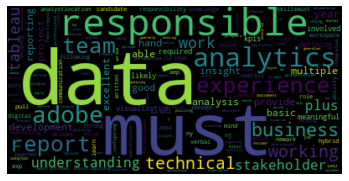


*** AeroVironment, Engineering Intern, Software - Application via WayUp ***



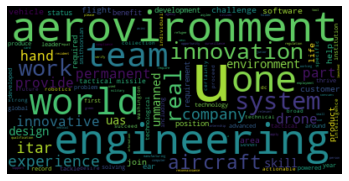


*** AeroVironment, Software Engineering Intern - Application via WayUp ***



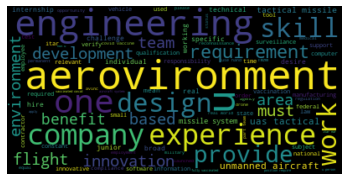


*** AeroVironment, Software Engineering Intern - Summer 2023 (Manassas, VA) - Application via WayUp ***



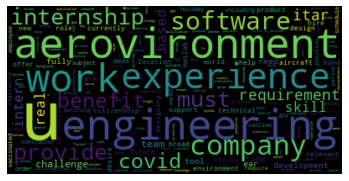


*** AeroVironment, Software Engineering Intern - Summer 2023 (Minneapolis, MN) - Application via WayUp ***



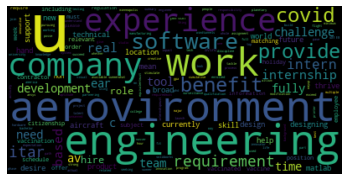


*** AeroVironment, Software Engineering Intern - Summer 2023 (Simi Valley, CA) - Application via WayUp ***



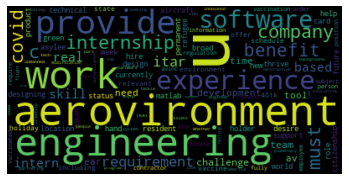


*** AeroVironment, Software Engineering Intern - Summer 2023 (Wilmington, MA) - Application via WayUp ***



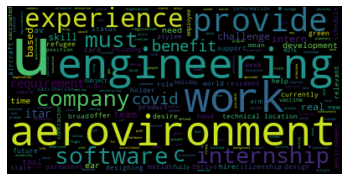


*** Alibaba Group Software Engineer Seattle, WA ***



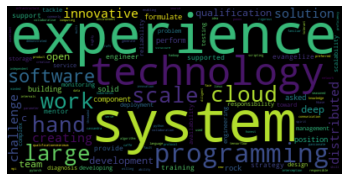


*** Analyst - Advanced Analytics ***



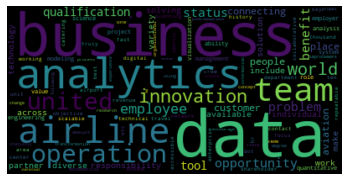


*** Analyst - SQL - Data storytelling / Data Insights ***



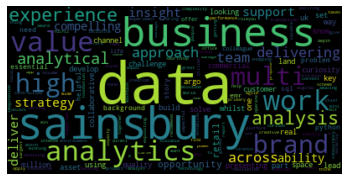


*** Analyst Reporting &amp; Analytics ***



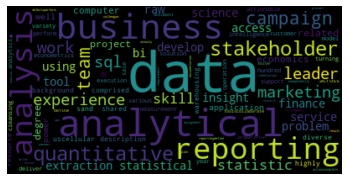


*** Analyst, Data and Analytics ***



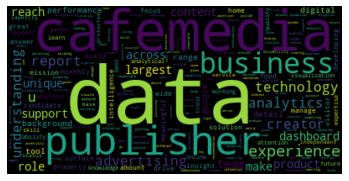


*** Analyst, Data and Insights, Homepage ***



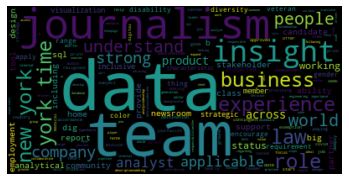


*** Analytical Data Scientist  ***



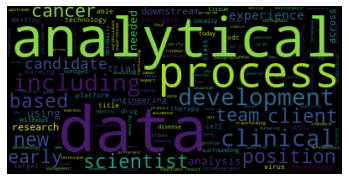


*** Application Security Engineer  ***



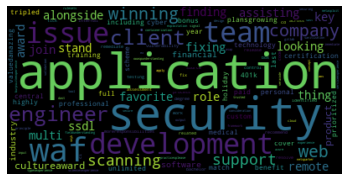


*** Applications Engineer- Early Career ***



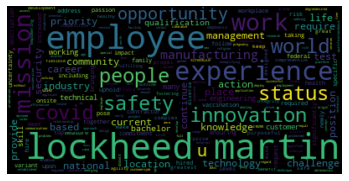


*** Assistant Planning/Data Analyst ***



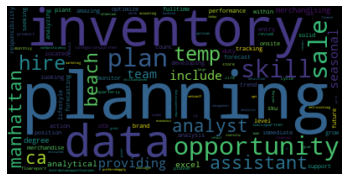


*** Assocaite Principal, Software Engineering (AWS Devops) - Hybrid ***



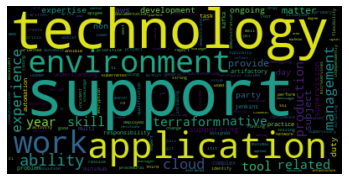


*** Associate Data Analyst ***



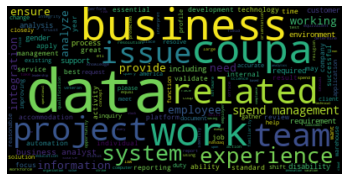


*** Associate Data Review Scientist- Biochemistry ***



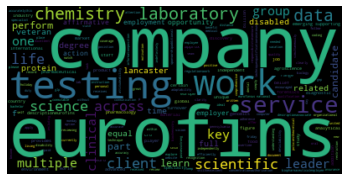


*** Associate Data Scientist ***



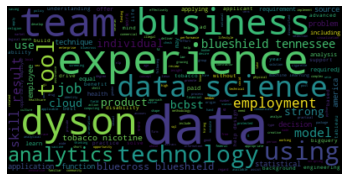


*** Associate Data Scientist, Product Security (New Grad / Early-in-Career) ***



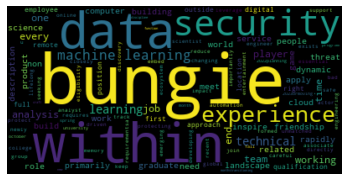


*** Associate Developer, IT Applications ***



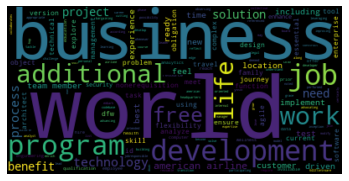


*** Associate Engineer ***



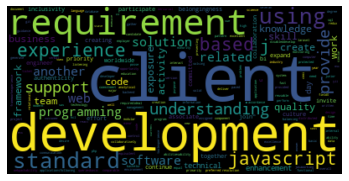


*** Associate Performance Test Engineer ***



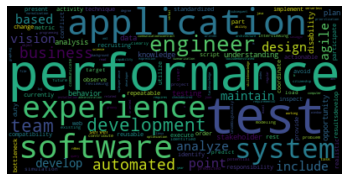


*** Associate Software Engineer ***



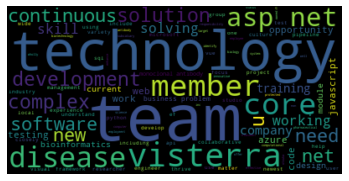


*** Autonomous Database Site Reliability Engineer  ***



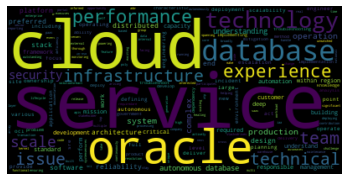


*** Aws Devops ***



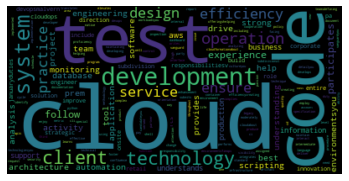


*** Azure Cloud Engineer ***



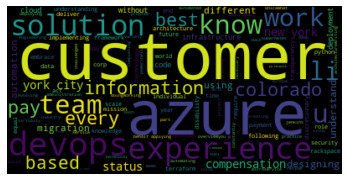


*** Azure DevOps ***



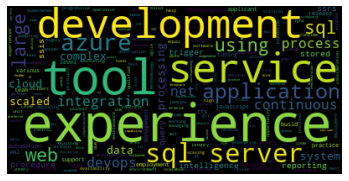


*** Azure Devops ***



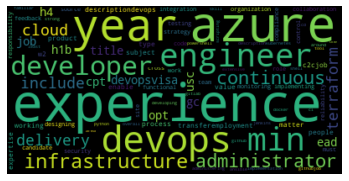


*** Azure ML Data scientist ***



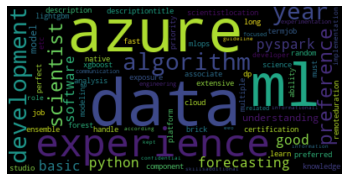


*** BI Data Analyst ***



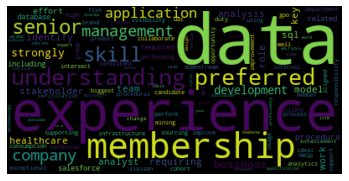


*** Back End Software Engineer ***



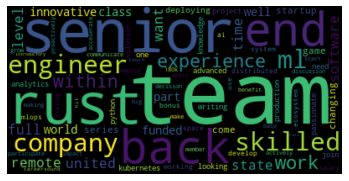


*** Backend Engineering, Apprenticeship ***



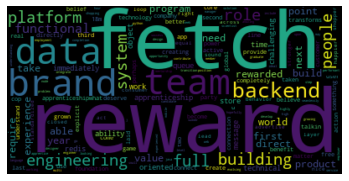


*** Backend Software Engineer ***



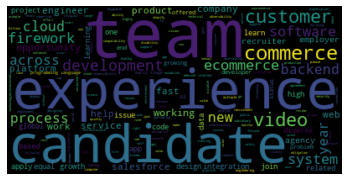


*** Backend Software Engineer Summer Intern ***



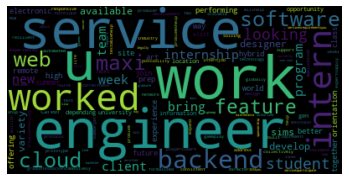


*** Backend Software Engineering Intern - Summer 2023 ***



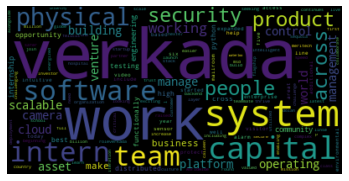


*** Bio Data Scientist ***



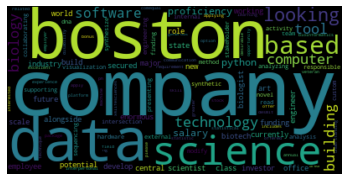


*** Biochemistry Scientist- (Entry Level) Data Review ***



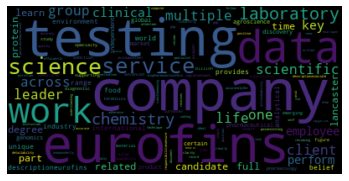


*** Biochemistry-Data Review Scientist (Entry Opportunity) ***



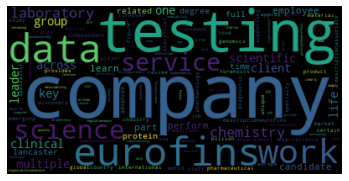


*** Biological Data Scientist ***



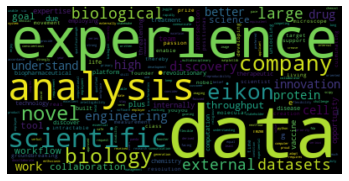


*** Business Data Analyst ***



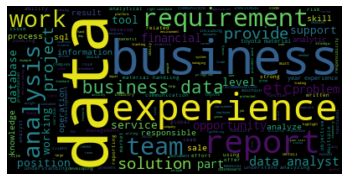


*** Business/Data Analyst ***



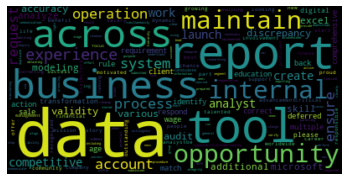


*** C++ Software Engineer  ***



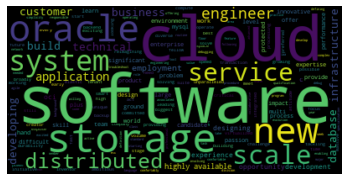


*** CA IDM Developer ***



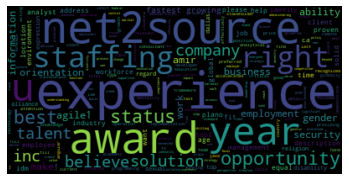


*** COVID Data Analyst ***



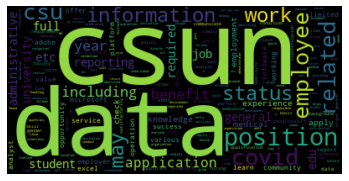


*** Client Data Analyst ***



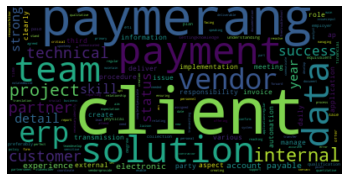


*** Cloud &amp; DevOps Solutions Engineer ***



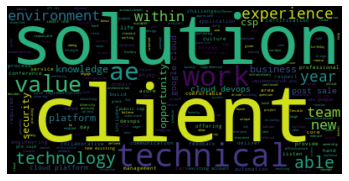


*** Cloud / Devops - MUST Be US Citizen with Secret Clearance ***



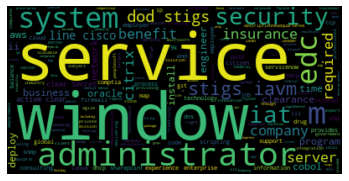


*** Cloud Cyber Security Engineer ***



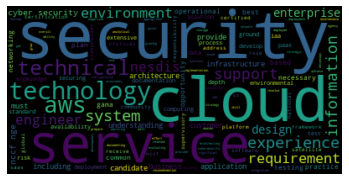


*** Cloud DevOps Engineer ***



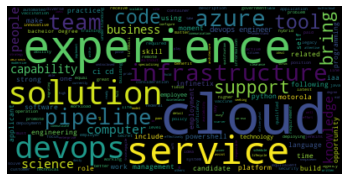


*** Cloud DevOps System Engineer ***



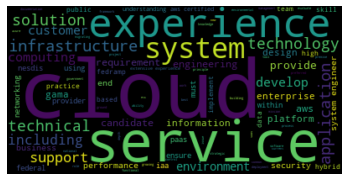


*** Cloud Engineer ***



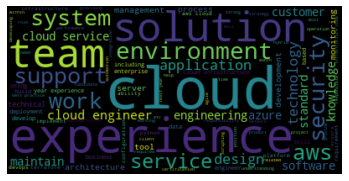


*** Cloud Engineer (Azure) - Seattle (HYBRID) ***



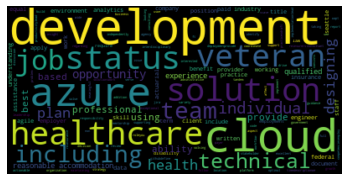


*** Cloud Engineer (Redshift) ***



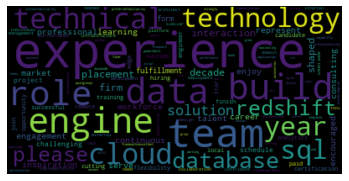


*** Cloud Engineer (SRE) Full Time ***



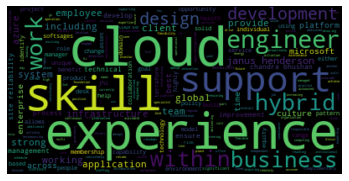


*** Cloud Engineer - Azure ***



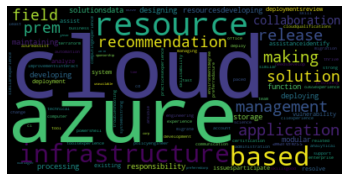


*** Cloud Engineer - Remote ***



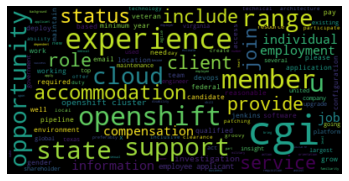


*** Cloud Engineer 2049 (Hybrid) ***



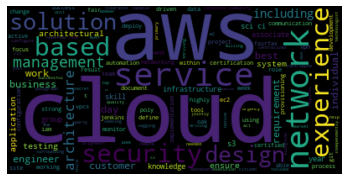


*** Cloud Engineer, 22-11835 ***



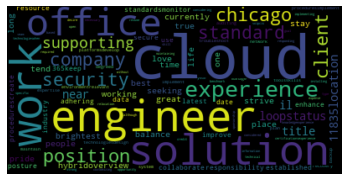


*** Cloud Engineer/SME ***



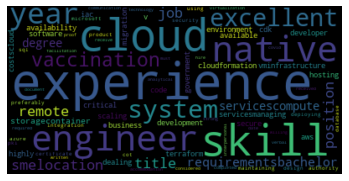


*** Cloud Infrastructure Engineer ***



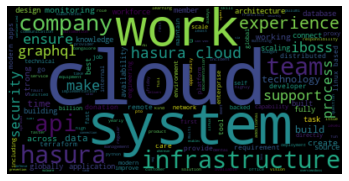


*** Cloud Infrastructure Engineer -Google Cloud Platform (GCP) ***



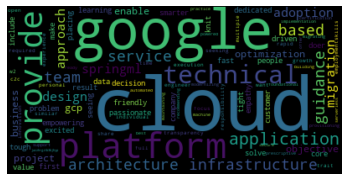


*** Cloud Platform Engineer ***



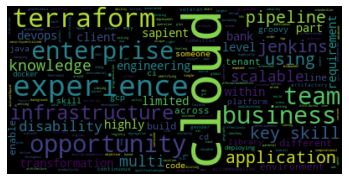


*** Cloud Security Engineer ***



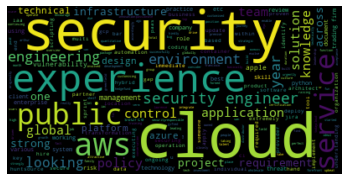


*** Cloud Security Engineer  ***



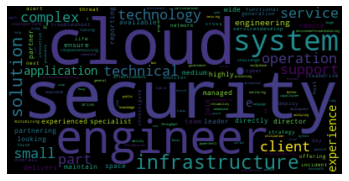


*** Cloud Services Engineer ***



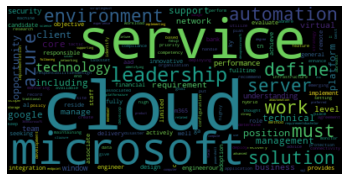


*** Cloud Solutions Engineer (Azure) - Seattle (HYBRID) ***



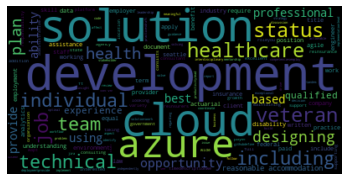


*** Cloud Storage Engineer ***



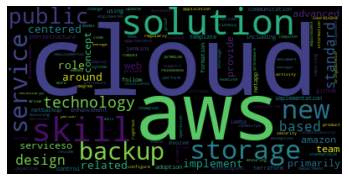


*** Computer Engineering Intern ***



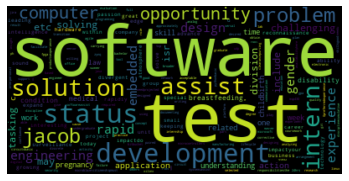


*** Computer Exploitation Engineer ***



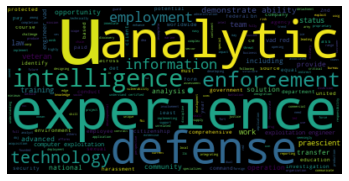


*** Cyber Software Engineer - Early Career ***



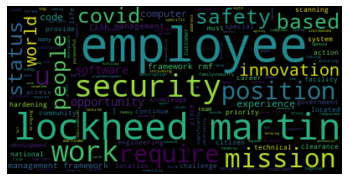


*** Cyber Threat Engineer ***



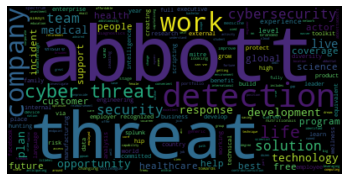


*** DATA ANALYST ***



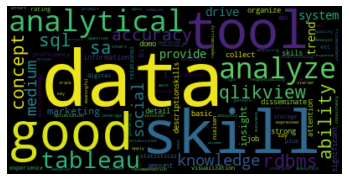


*** DATA ANALYST I ***



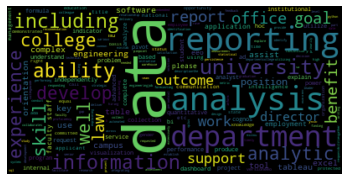


*** DATA SCIENTIST ***



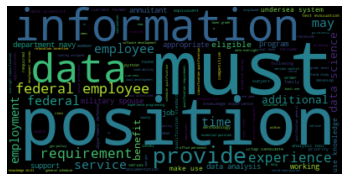


*** DATA SCIENTIST - MCEVBD ***



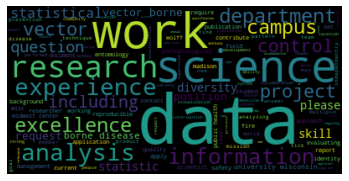


*** DLP Engineer ***



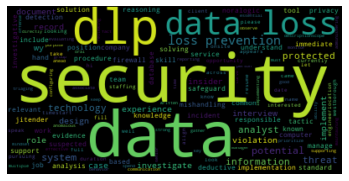


*** Data &amp; Applied Scientist ***



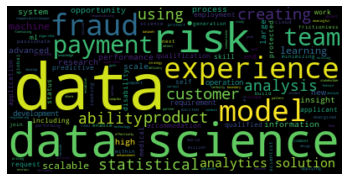


*** Data &amp; Evaluation Scientist ***



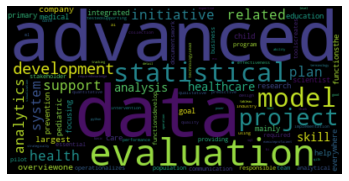


*** Data Analyst ***



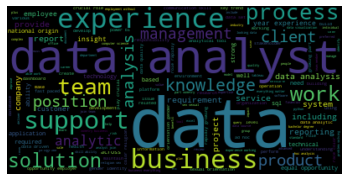


*** Data Analyst  ***



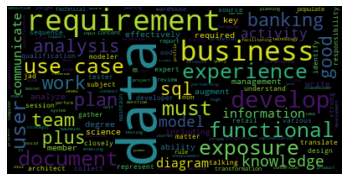


*** Data Analyst ( REMOTE) ***



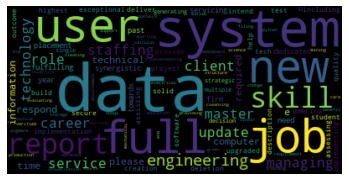


*** Data Analyst (Business/Energy Market Analyst) ***



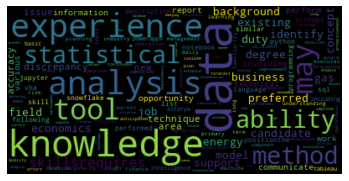


*** Data Analyst (REMOTE) ***



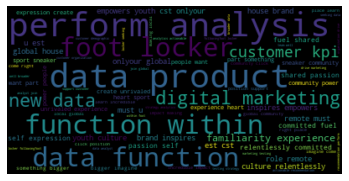


*** Data Analyst (SAS) ***



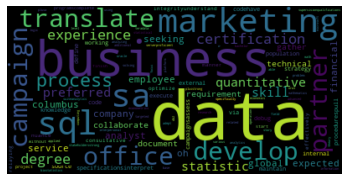


*** Data Analyst (Tableau) ***



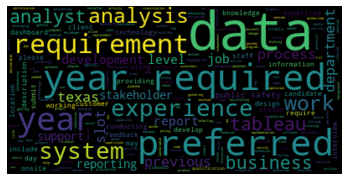


*** Data Analyst (hybrid-remote) ***



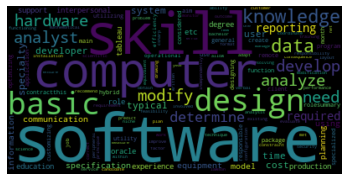


*** Data Analyst (local candidates strongly preferred) ***



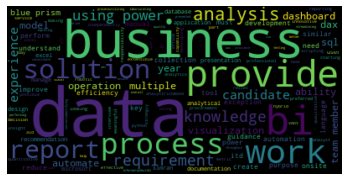


*** Data Analyst - 3742 ***



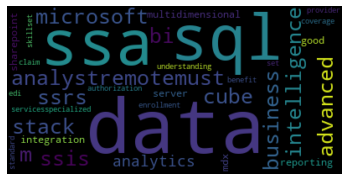


*** Data Analyst - Austin, TX 78727 (100% remote) - 6 months contract ***



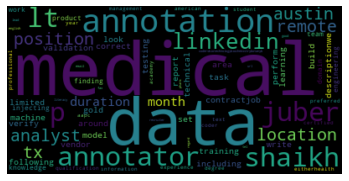


*** Data Analyst - Customer Intelligence ***



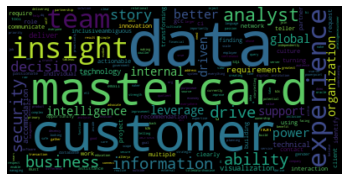


*** Data Analyst - Full-time role ***



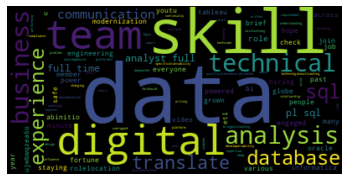


*** Data Analyst - Fully Remote ***



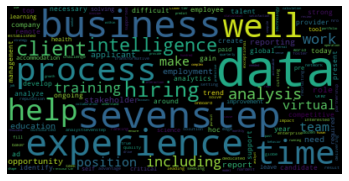


*** Data Analyst - Hybrid (Nashville, TN) ***



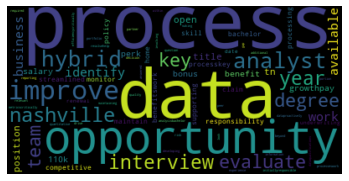


*** Data Analyst - Operations ***



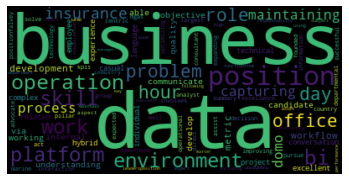


*** Data Analyst - Overwatch ***



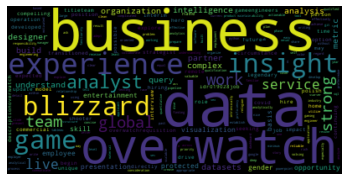


*** Data Analyst - Remote ***



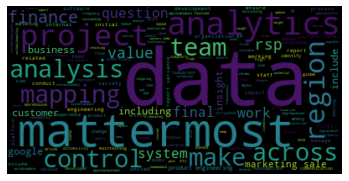


*** Data Analyst - Reporting ***



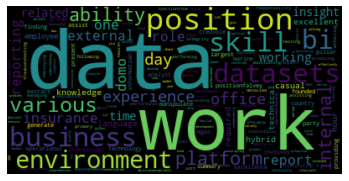


*** Data Analyst / Information Analyst ***



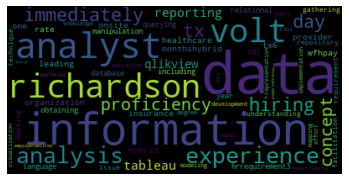


*** Data Analyst / Platform Experience ***



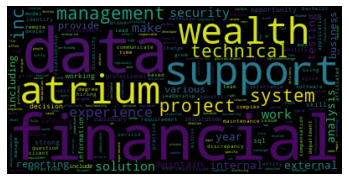


*** Data Analyst 3 - Anaplan ***



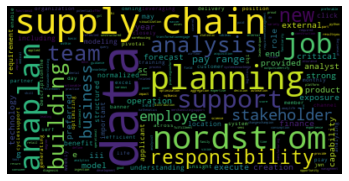


*** Data Analyst I ***



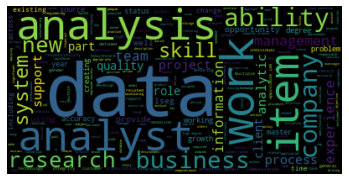


*** Data Analyst II ***



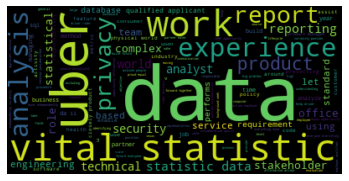


*** Data Analyst III  ***



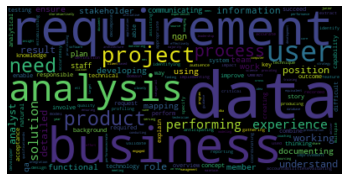


*** Data Analyst Intern - 42162BR ***



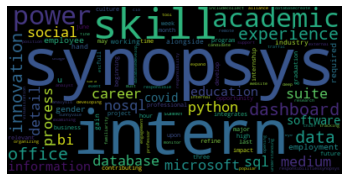


*** Data Analyst remote position ***



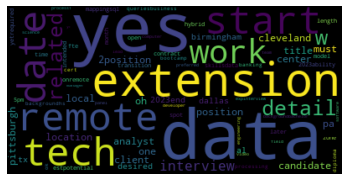


*** Data Analyst, Careers ***



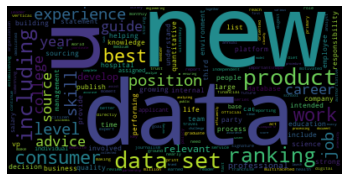


*** Data Analyst, FIRST Account ***



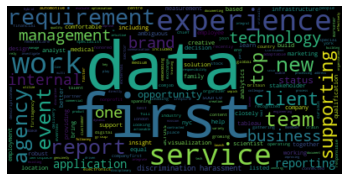


*** Data Analyst, Performance Marketing ***



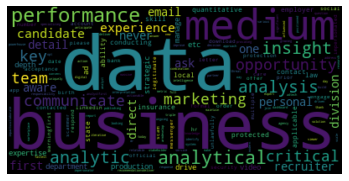


*** Data Analyst, QMS ***



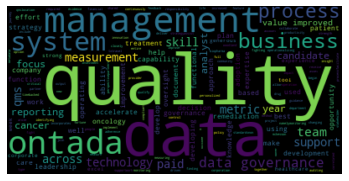


*** Data Analyst, University Graduate (Privacy and Data Protection Office)- 2023 Start (BS/MS) ***



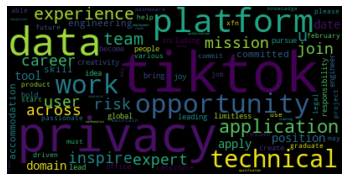


*** Data Analyst- Supply Chain ***



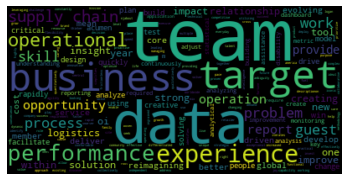


*** Data Analyst- Supply Chain Data Quality (Remote) ***



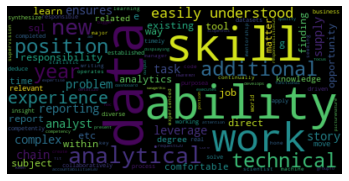


*** Data Analyst- W2 only  ***



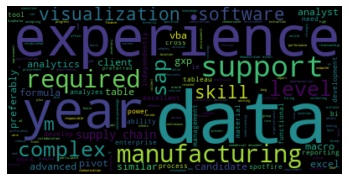


*** Data Analyst-Full Time ***



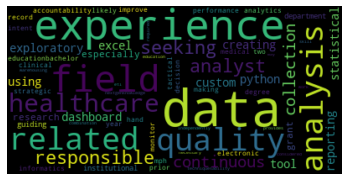


*** Data Analyst-Remote ***



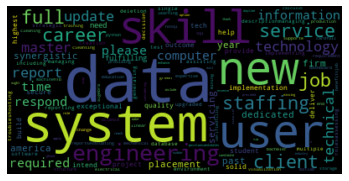


*** Data Analyst. ***



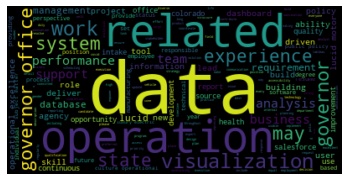


*** Data Analyst/ $100M Valuation/ Benefits Fully Covered  ***



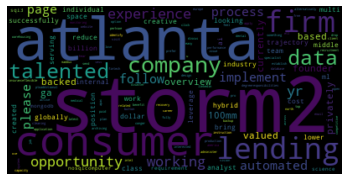


*** Data Analyst/Manager ***



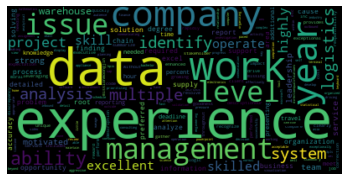


*** Data Analyst/Programmer (Research Assistant 2) ***



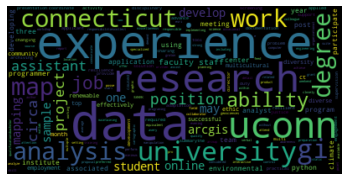


*** Data Analyst/SQL Analyst ***



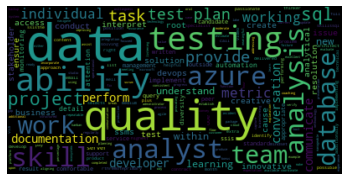


*** Data Analyst|$130K-$150K + ESOP|100% USA-Remote ***



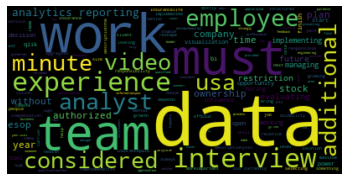


*** Data Analytics Intern ***



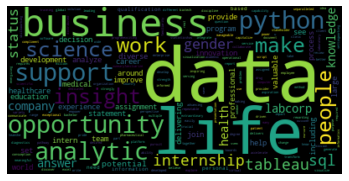


*** Data Cloud Engineer ***



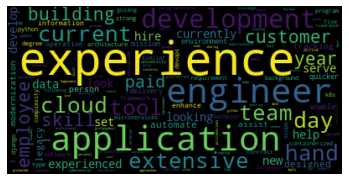


*** Data Enablement Analyst - Remote ***



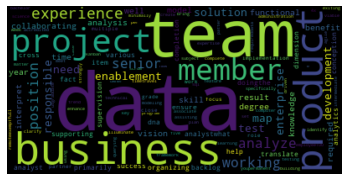


*** Data Engineer ***



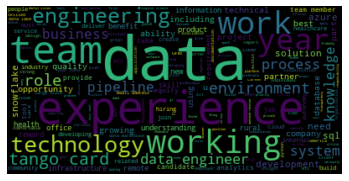


*** Data Engineer (North America) ***



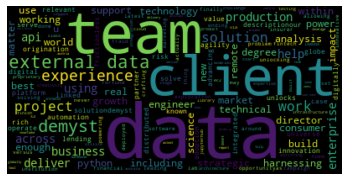


*** Data Engineer (Remote Option*) ***



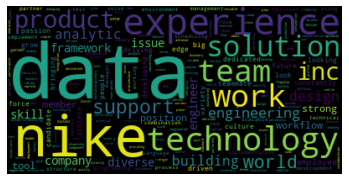


*** Data Engineer (Remote) ***



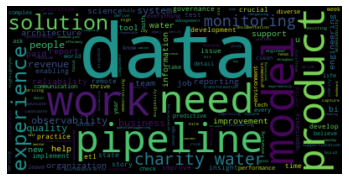


*** Data Engineer - Remote ***



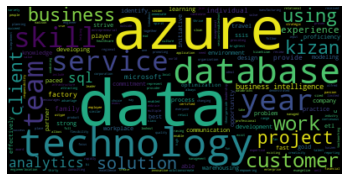


*** Data Engineer - Strat Hire - Orlando/Dallas ***



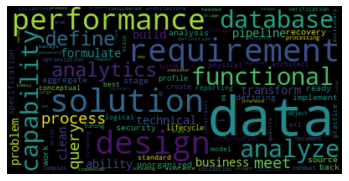


*** Data Engineer Intern ***



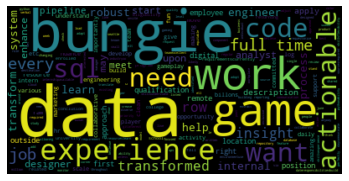


*** Data Engineer Intern - 42061BR ***



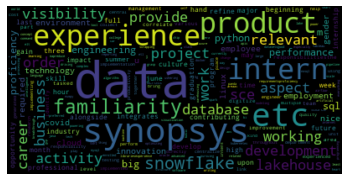


*** Data Engineer, Snowflake ***



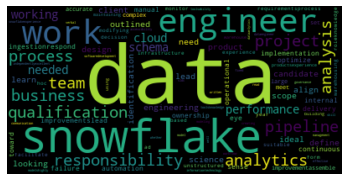


*** Data Entry Analyst ***



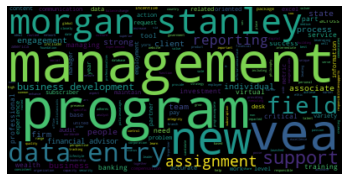


*** Data Entry Analyst - 4141 ***



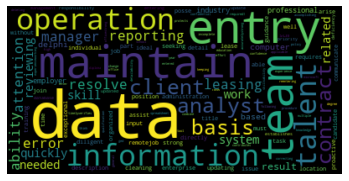


*** Data Governance Analyst ***



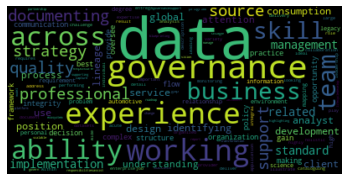


*** Data Insight Analyst ***



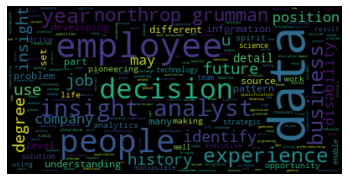


*** Data Integration Engineer ***



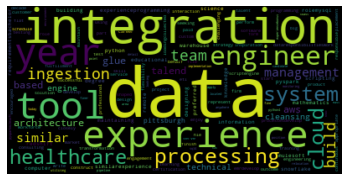


*** Data Mapping Analyst ***



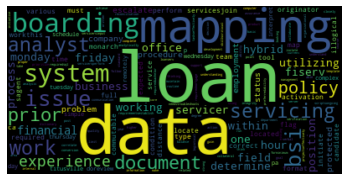


*** Data Processing Programmer Intern (Summer Session) ***



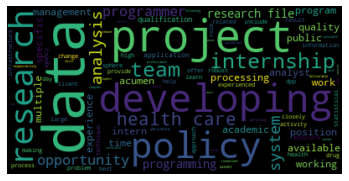


*** Data Quality Analyst/Data Analyst ***



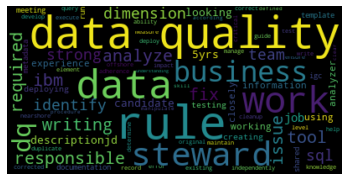


*** Data Reporting Analyst ***



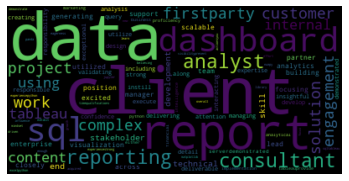


*** Data Research Analyst ***



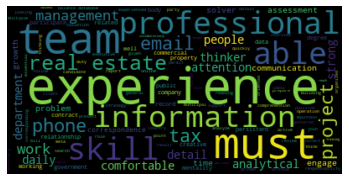


*** Data Review Scientist ***



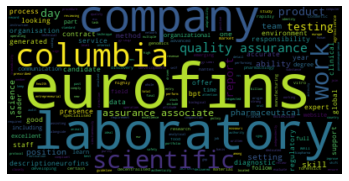


*** Data Review Scientist - Entry Level ***



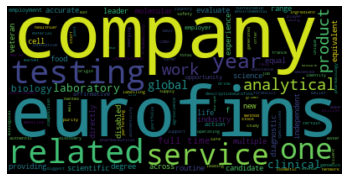


*** Data Review Scientist- Medical Device ***



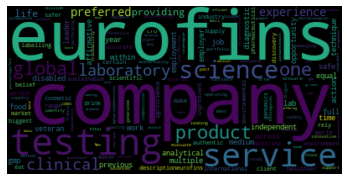


*** Data Science &amp; Machine Learning Engineer ***



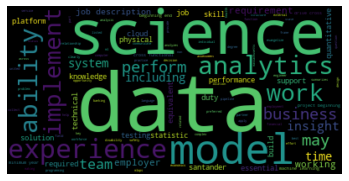


*** Data Science R&amp;D - Graduate Intern ***



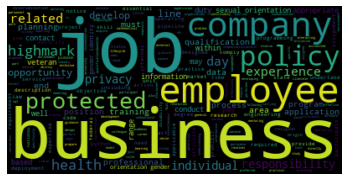


*** Data Scientist ***



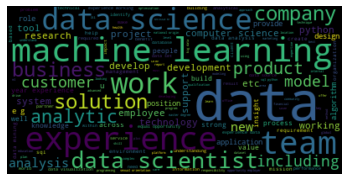


*** Data Scientist ( consumer-facing technology) ***



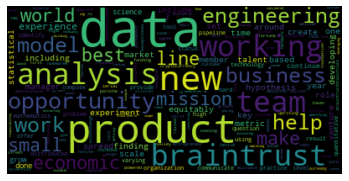


*** Data Scientist (12+ years exp mandatory) ***



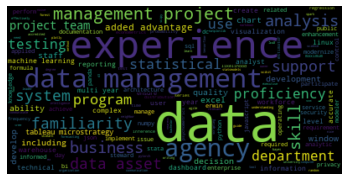


*** Data Scientist (2022-0260) ***



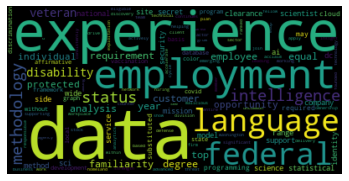


*** Data Scientist (70442) ***



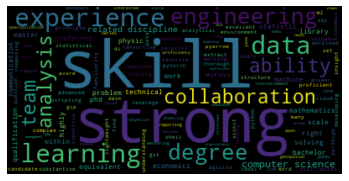


*** Data Scientist (Computational Biologist) ***



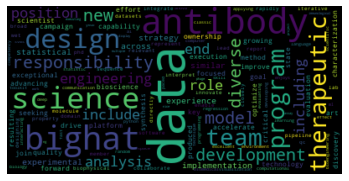


*** Data Scientist (Data Analytics and AI) ***



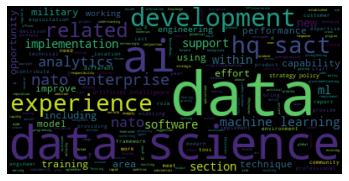


*** Data Scientist (Deep Learning, ML, NLP) ***



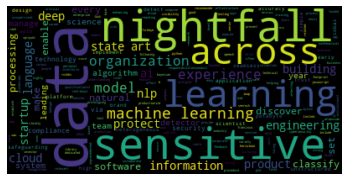


*** Data Scientist (Full Time) ***



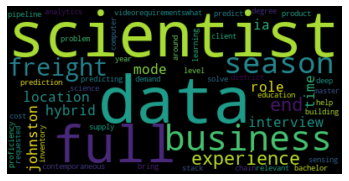


*** Data Scientist (Mid)-Data &amp; Analytics-IT-CS-US BAY1JP00015686 -REMOTE  (C2C-NOT ALLOWED ***



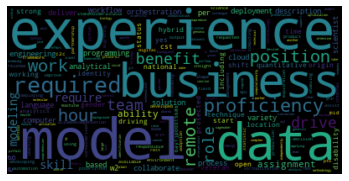


*** Data Scientist (Must have Recommendation or Forecast Modeling Experience)  ***



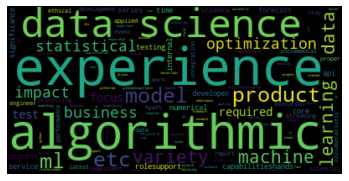


*** Data Scientist (NLP - Natural Language Processing) ***



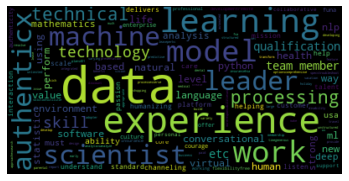


*** Data Scientist (Only w2) ***



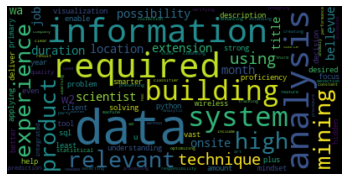


*** Data Scientist (Python, Machine Learning) -22-01551 ***



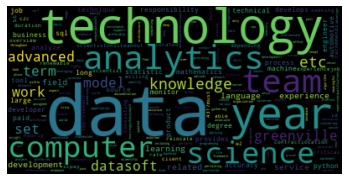


*** Data Scientist (Real-time Ops) ***



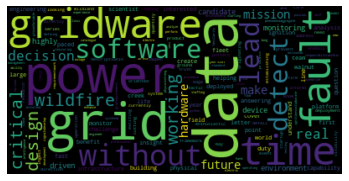


*** Data Scientist (Remote) ***



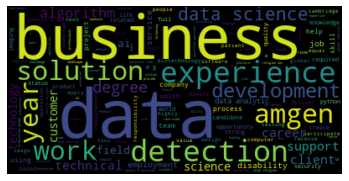


*** Data Scientist (local candidates strongly preferred) ***



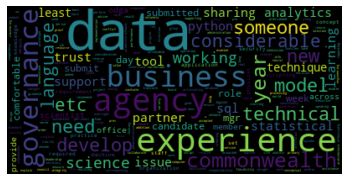


*** Data Scientist (remote) ***



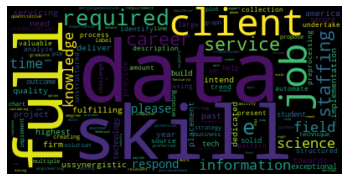


*** Data Scientist - AWS, NLP ***



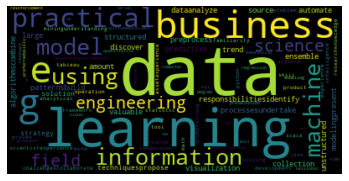


*** Data Scientist - Advanced Analytics ***



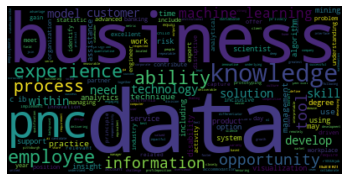


*** Data Scientist - CAISO ***



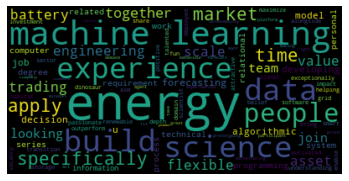


*** Data Scientist - Data Analyst ***



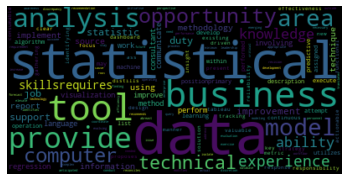


*** Data Scientist - Entry Level ***



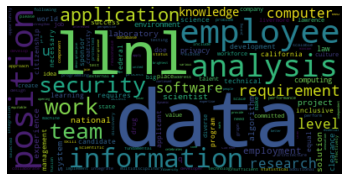


*** Data Scientist - II ***



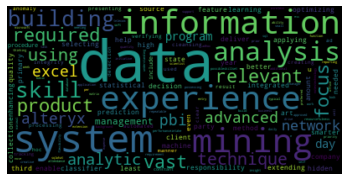


*** Data Scientist - Junior ***



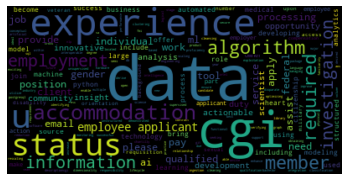


*** Data Scientist - Machine Learning Engineer ***



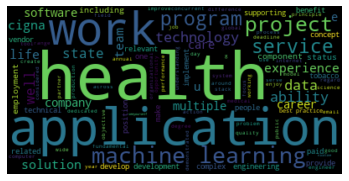


*** Data Scientist - Marketing ***



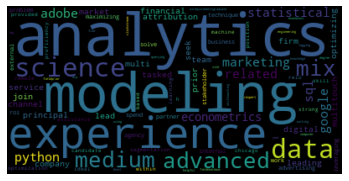


*** Data Scientist - Neo4J ***



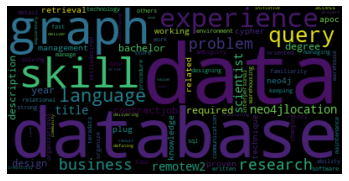


*** Data Scientist - Onsite in Richmond, VA w/some remote flex ***



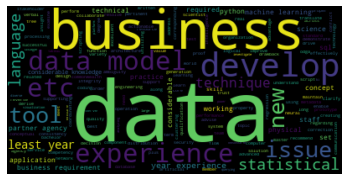


*** Data Scientist - Opportunity for Working Remotely ***



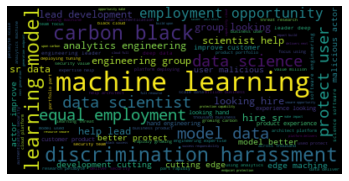


*** Data Scientist - San Jose ***



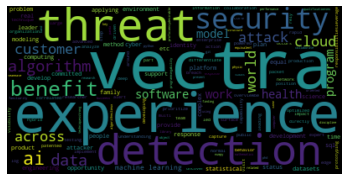


*** Data Scientist - Statistical Modeling ***



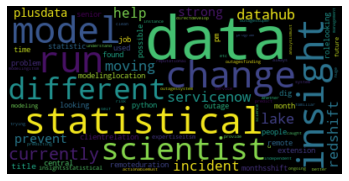


*** Data Scientist - Systematic Strategies ***



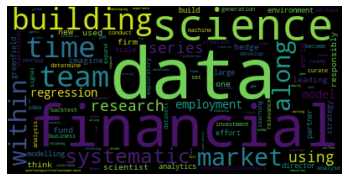


*** Data Scientist / Analyst - Junior Level ***



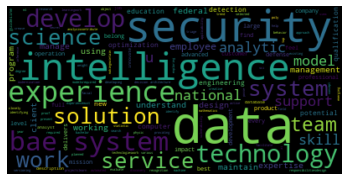


*** Data Scientist / Numerical Simulation Engineer ***



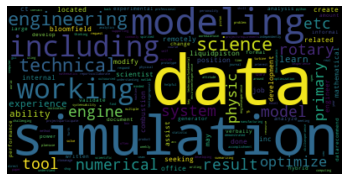


*** Data Scientist 2 ***



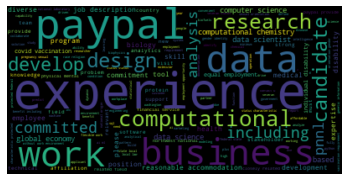


*** Data Scientist 2 (Remote) ***



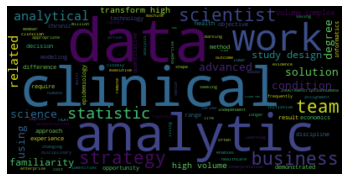


*** Data Scientist 2 - Remote ***



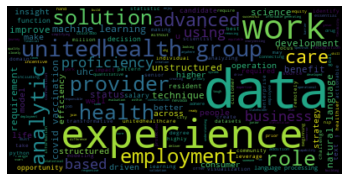


*** Data Scientist 3 ***



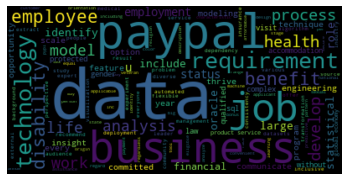


*** Data Scientist Associate 1 ***



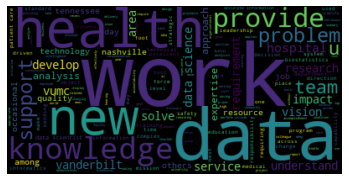


*** Data Scientist Associate I-Neurology ***



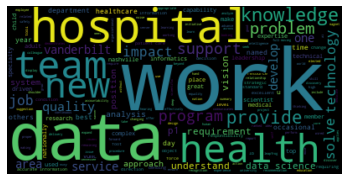


*** Data Scientist Co-Op ***



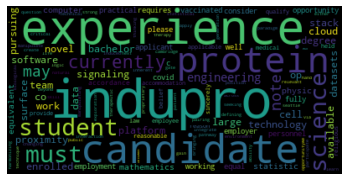


*** Data Scientist I ***



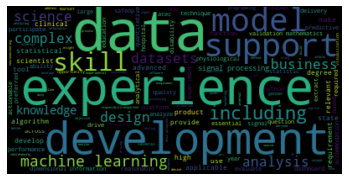


*** Data Scientist I, Biophysics ***



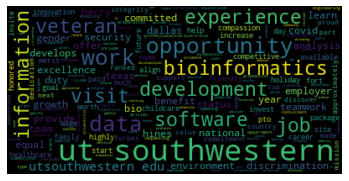


*** Data Scientist I, Risk Analytics ***



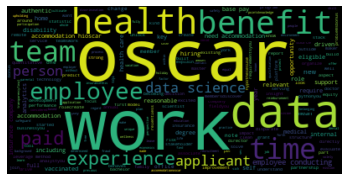


*** Data Scientist II ***



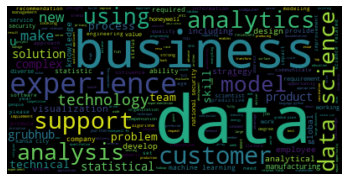


*** Data Scientist II (Remote) ***



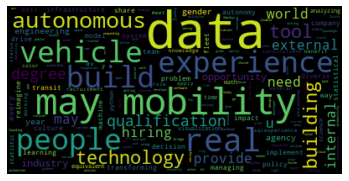


*** Data Scientist III ***



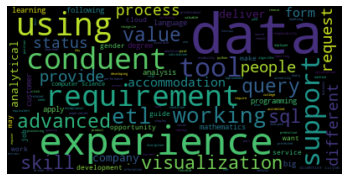


*** Data Scientist III - (B3) ***



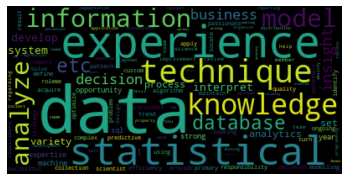


*** Data Scientist III Advanced Analytics - Python, ML ***



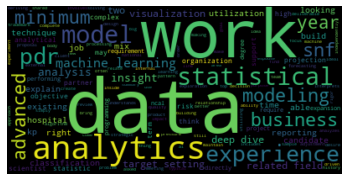


*** Data Scientist III Data Science ***



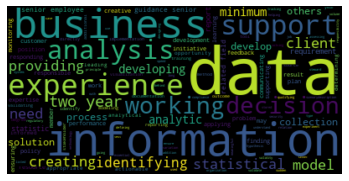


*** Data Scientist IV ***



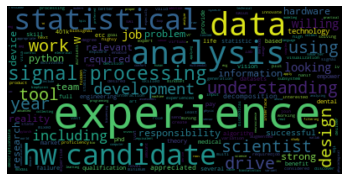


*** Data Scientist Intern ***



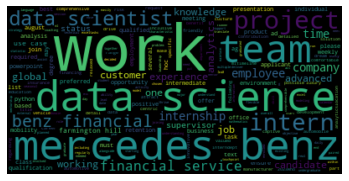


*** Data Scientist Intern (Remote) ***



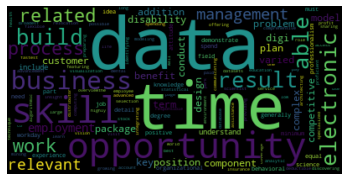


*** Data Scientist Internship ***



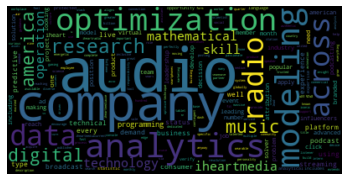


*** Data Scientist Internship - ML (US) ***



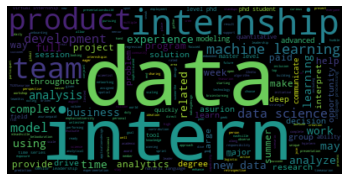


*** Data Scientist Internship - OR (US) ***



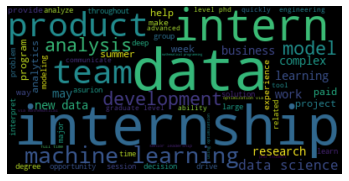


*** Data Scientist V ***



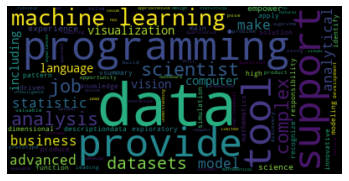


*** Data Scientist V Data Science ***



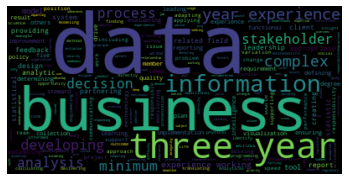


*** Data Scientist and Engineer ***



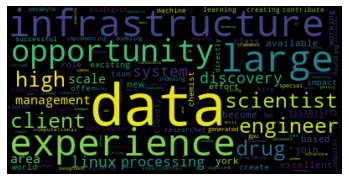


*** Data Scientist for Credit Analytics ***



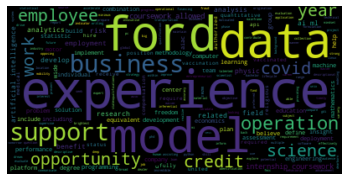


*** Data Scientist in Space Science and Security ***



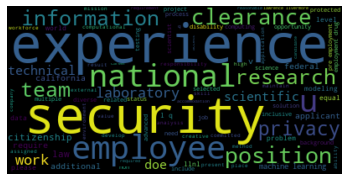


*** Data Scientist with Lidar Experience ***



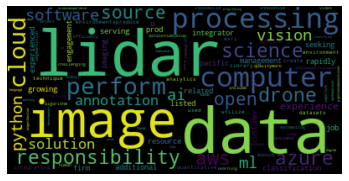


*** Data Scientist(Onsite) ***



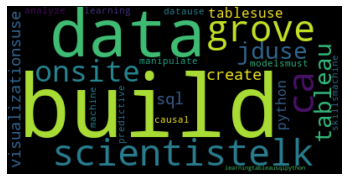


*** Data Scientist, Advanced Analytics &amp; Decision Analytics ***



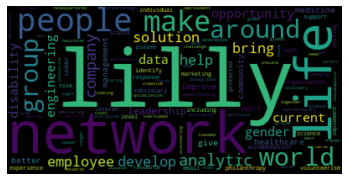


*** Data Scientist, Associate ***



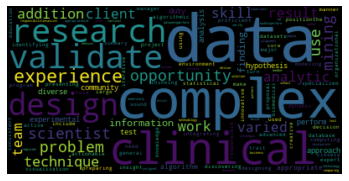


*** Data Scientist, Bioinformatics ***



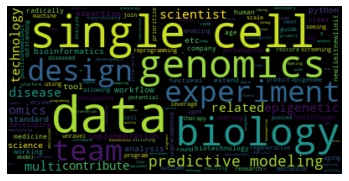


*** Data Scientist, Freemium Analytics ***



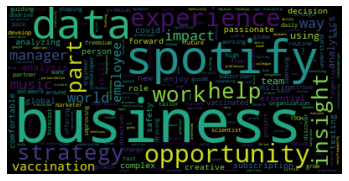


*** Data Scientist, Industrial Affairs ***



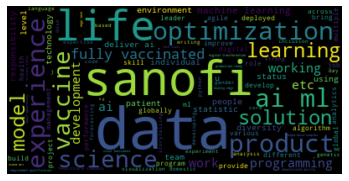


*** Data Scientist, Intern ***



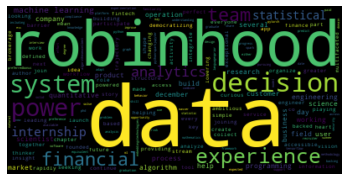


*** Data Scientist, Marketing ***



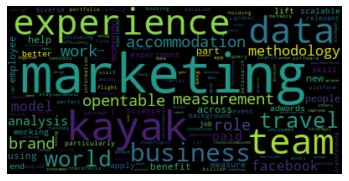


*** Data Scientist, University Graduate (Global E-commerce Risk Control)- 2023 Start (MS) ***



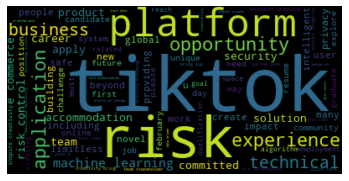


*** Data Scientist- Visa Consulting and Analytics- Masters New College Grad- Atlanta- 2023 ***



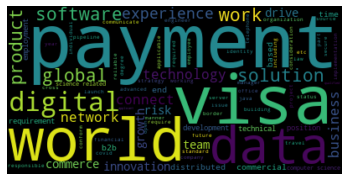


*** Data Scientist-Mid ***



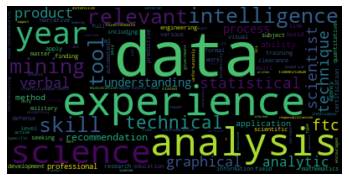


*** Data Scientist/ Engineer ***



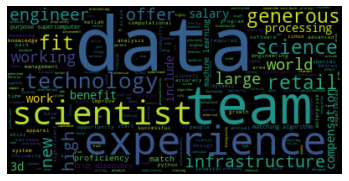


*** Data Scientist/Analyst Intern or Co-op - Spring &amp; Summer 2023 ***



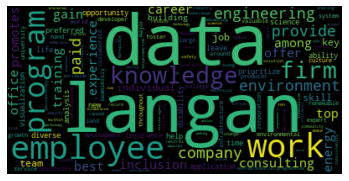


*** Data Scientist/Analytics-ITSM ***



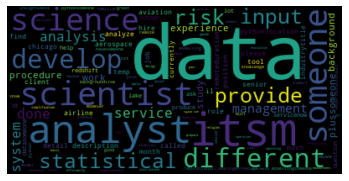


*** Data Scientist/Python/ML(Fulltime) ***



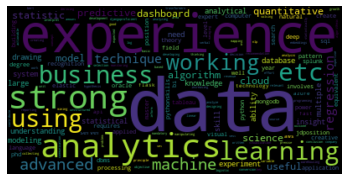


*** Data Scientist/Statistician (Remote) ***



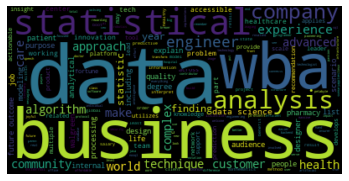


*** Data Strategy, Data Scientist – Equity Research ***



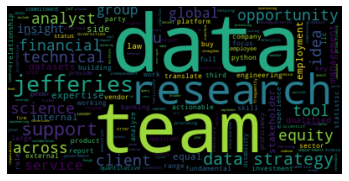


*** Data Visualization Analyst ***



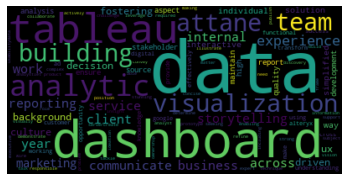


*** Data analyst ***



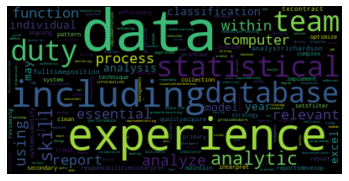


*** Data analyst(Power BI) ***



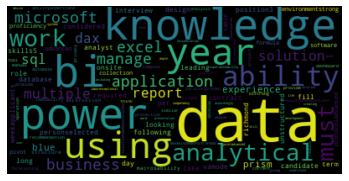


*** Data and Visualization Analyst ***



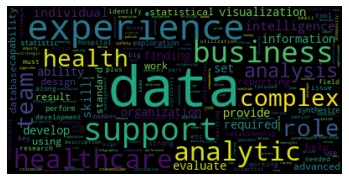


*** Data scientist with ITSM skills  ***



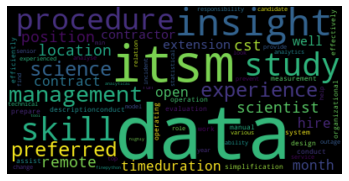


*** Decision Scientist II ***



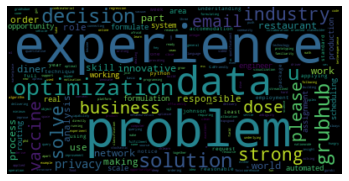


*** Deep Learning Data Scientist ***



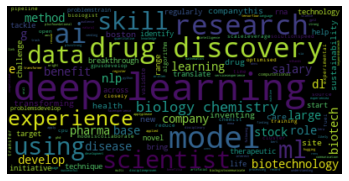


*** Department of Informatics and Analytics, Data Science &amp; AI Internship ***



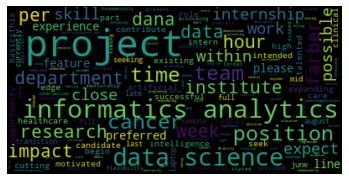


*** Design Engineering Intern ***



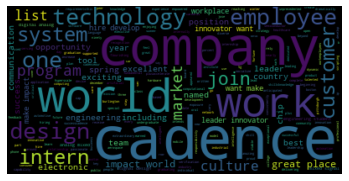


*** Dev/Sec/Ops Engineer(Terraform &amp; Sentinel Policy-as-Code Experience) - Only W2/Independent Contractor - Remote role ***



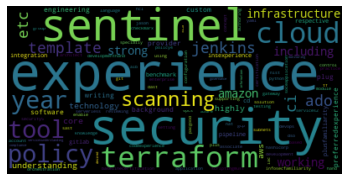


*** DevOps ***



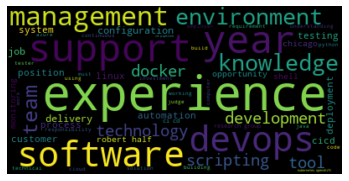


*** DevOps / SRE (Americas timezone- West Coast) ***



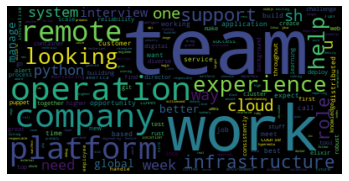


*** DevOps /SRE Engineer ***



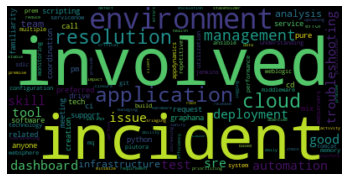


*** DevOps Analyst ***



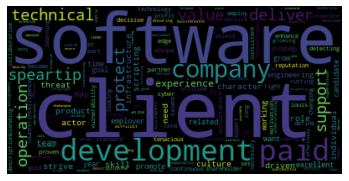


*** DevOps Automation ***



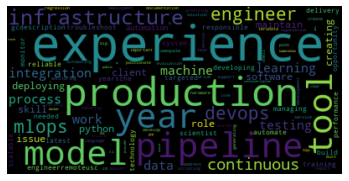


*** DevOps Deployment ***



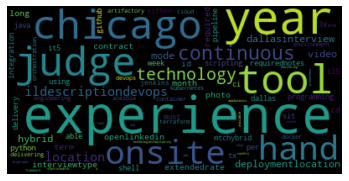


*** DevOps Development ***



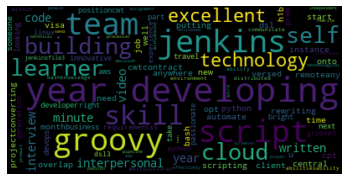


*** DevOps Engineer ***



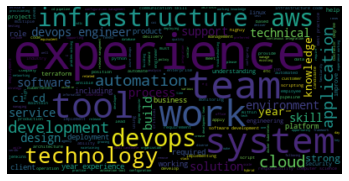


*** DevOps Engineer (App Support) ***



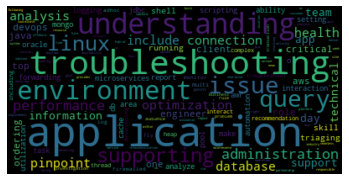


*** DevOps Engineer (Kubernetes/Docker) ***



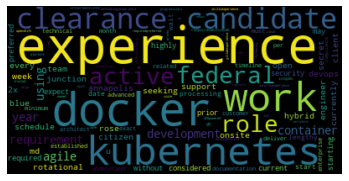


*** DevOps Engineer (Part-Time Ok) ***



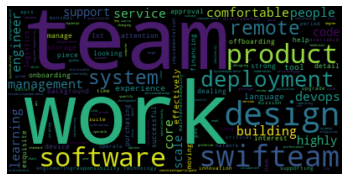


*** DevOps Engineer - Argo CD ***



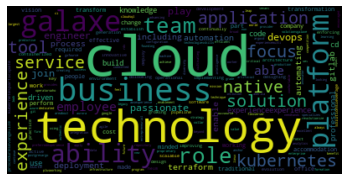


*** DevOps Engineer - Fulltime Job - Sponsorship &amp; Relocation available ***



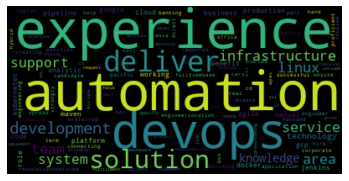


*** DevOps Engineer - Postgres ***



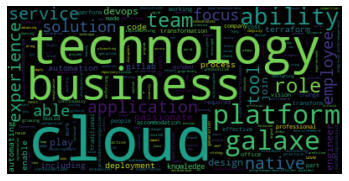


*** DevOps Engineer - Remote ***



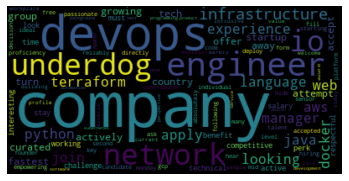


*** DevOps Engineer - Top Hedge Fund ***



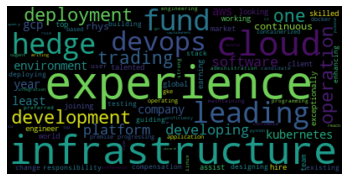


*** DevOps Engineer // Mid-Level ***



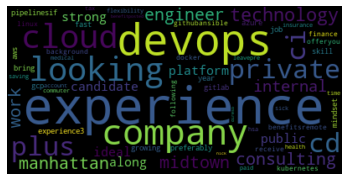


*** DevOps Engineer to join a Ground-Breaking Software Development Company - REMOTE - $200k Package ***



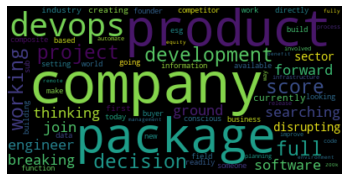


*** DevOps Engineer(D365) ***



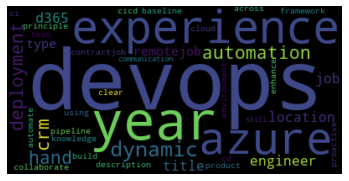


*** DevOps Engineer(Hybrid Role-3 Days Onsite) ***



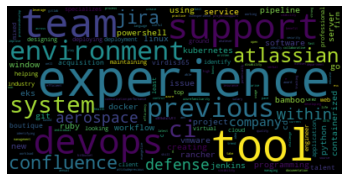


*** DevOps Engineer, Google Cloud Platform (GCP) [Remote] ***



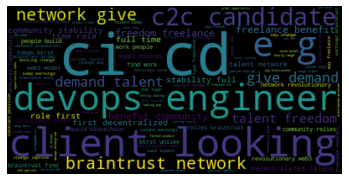


*** DevOps Engineer- Configuration - Build Release ***



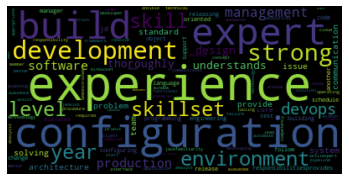


*** DevOps Engineering Intern ***



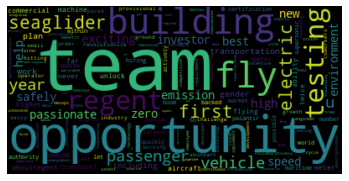


*** DevOps Engineering Internship Program (US) ***



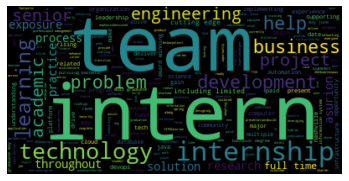


*** DevOps Engineers &amp; Specialists ***



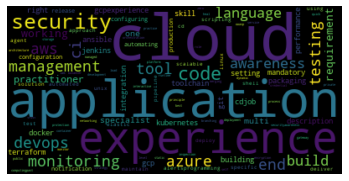


*** DevOps Internship - 35807 ***



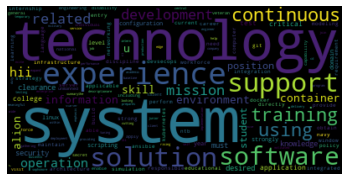


*** DevOps L2 Production Support ***



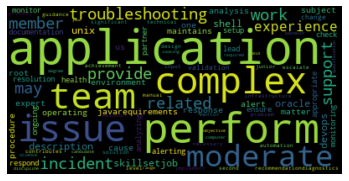


*** DevOps Lead Engineer ***



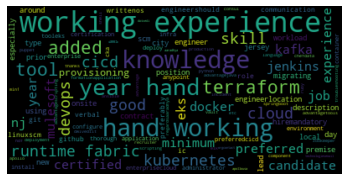


*** DevOps Specialist ***



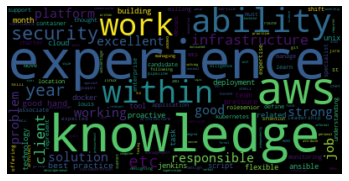


*** DevOps Tester Professional ***



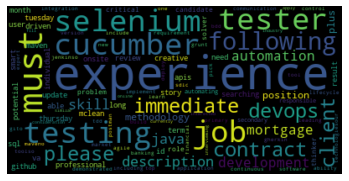


*** DevOps and End to End Testing Project ***



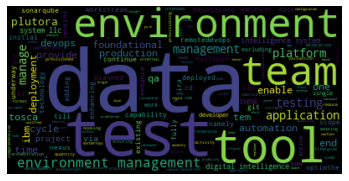


*** DevOps for an AI-Enabled Legal SaaS ***



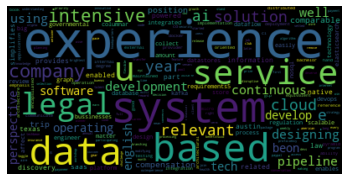


*** DevOps with Docker ***



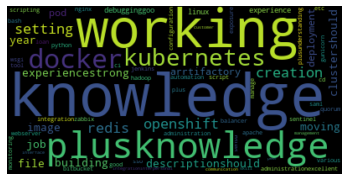


*** DevOps with EKS ***



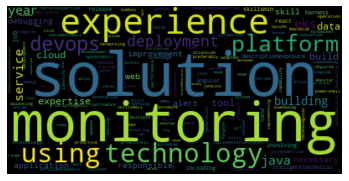


*** DevOps with Gitlab ***



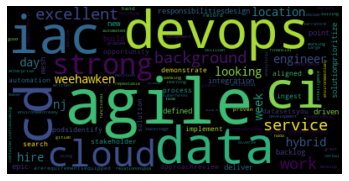


*** DevOps with Salesforce ***



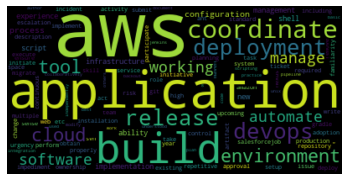


*** DevOps/SRE ***



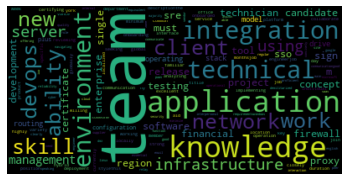


*** DevOps/Site Reliability Engineering ***



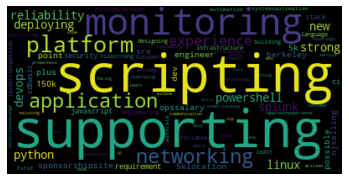


*** DevSecOps Engineer ***



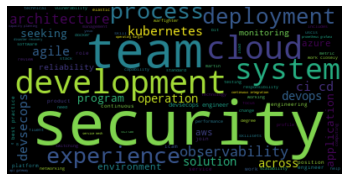


*** DevSecOps Engineer - 100% Remote ***



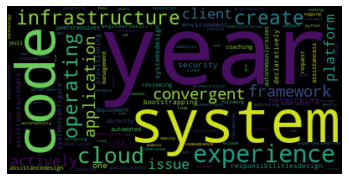


*** Developer, IT Applications ***



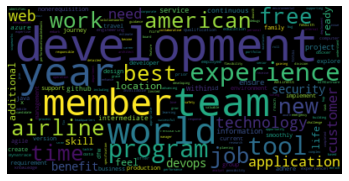


*** Devops ***



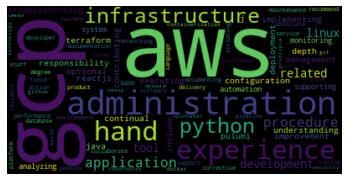


*** Devops Build/ Release ***



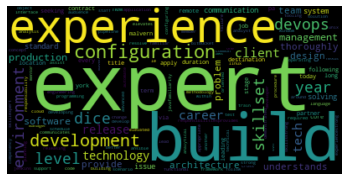


*** Devops Engineer ***



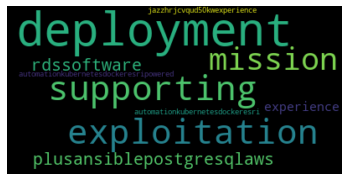


*** Devops Engineer (Automation) ***



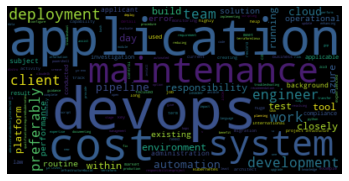


*** Devops Engineer (Entry To Jr. Level) ***



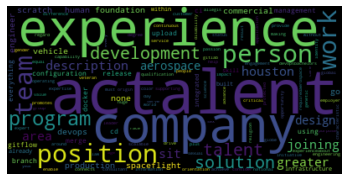


*** Devops Engineer -Openshift  ***



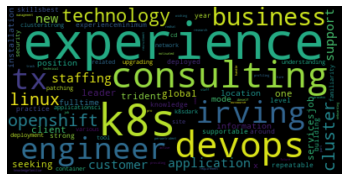


*** Devops Engineer II ***



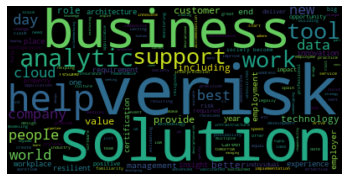


*** Devops First Hire ***



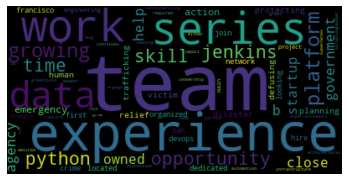


*** Devops Infrastructure ***



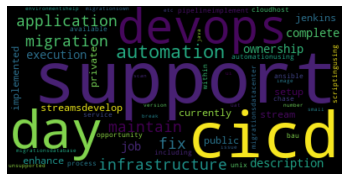


*** Devops Production Support Specialist ***



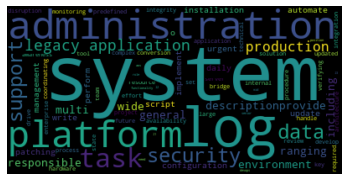


*** Devops Tools Support Analyst ***



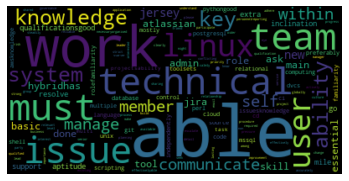


*** Devops-SRE) || Day 1 onsite || Austin TX ***



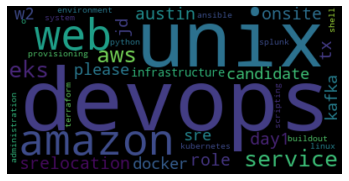


*** Devops/SRE Engineer ***



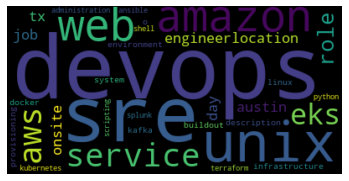


*** Differential Privacy: Data Scientist ***



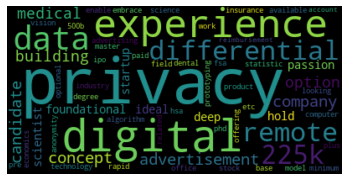


*** Digital Marketing - Data Analyst (Hybrid) ***



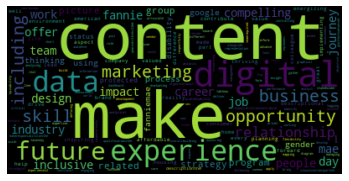


*** Digital Solutions | DevOps with Splunk ***



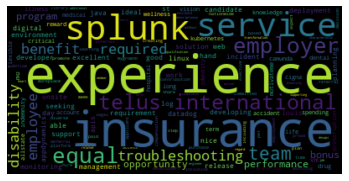


*** Direct client position-Devops Engineer with Docker/Kubernetes and AWS-Remote ***



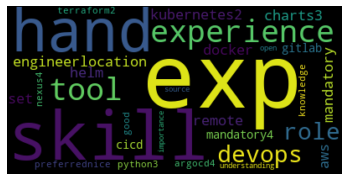


*** Docker + DevOps ***



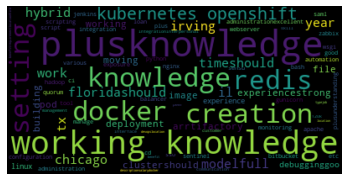


*** Docker+Devops(Fulltime) ***



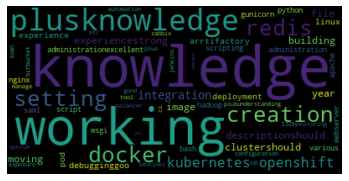


*** Early Career Software Engineer - Java Focus ***



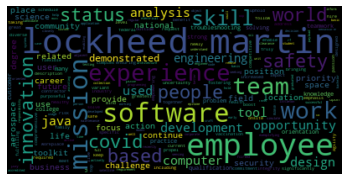


*** Embedded Software Development Intern (Summer 2023) - Avon, CT ***



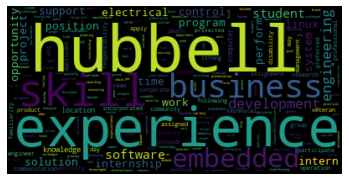


*** Embedded Software Engineer ***



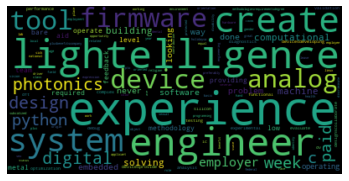


*** Embedded Software Engineering Co-Op (Spring '23) ***



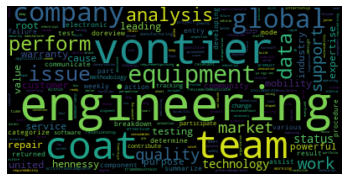


*** Engine Software Engineer Intern ***



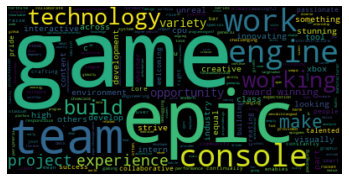


*** Engineer ***



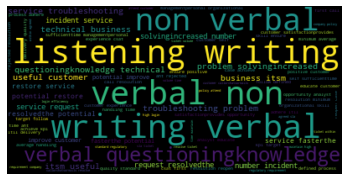


*** Engineering Intern - Summer 2023 ***



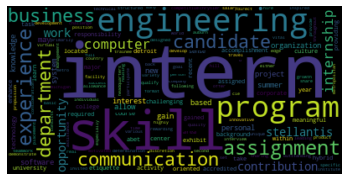


*** Engineering Intern Summer 2023 ***



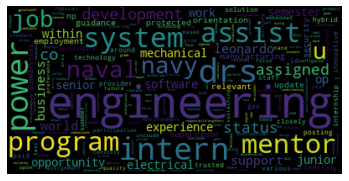


*** Entry Level Data Analyst ***



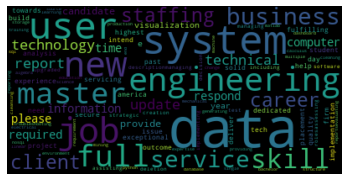


*** Entry Level Data Analyst - Full time (Remote) ***



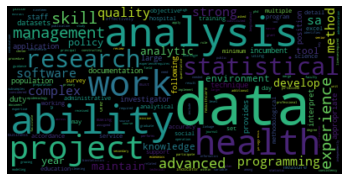


*** Entry Level Data Scientist ***



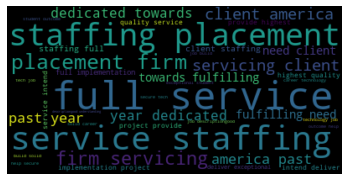


*** Entry Level Developer  ***



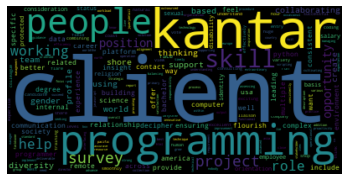


*** Entry Level Engineer ***



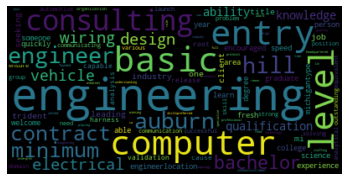


*** Entry Level Software Engineer ***



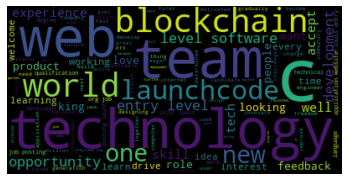


*** Entry Level Systems Performance Engineer ***



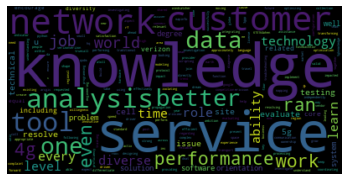


*** Entry Level data Analyst ***



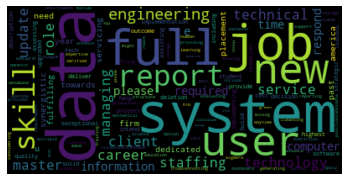


*** Entry Level: DevOps Engineer ***



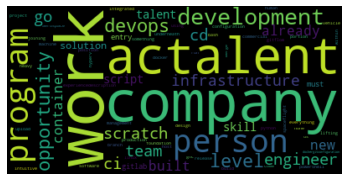


*** Entry level Systems Engineer ***



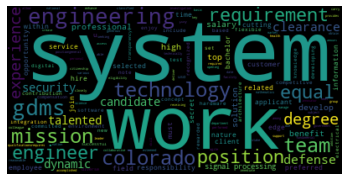


*** Equity Derivatives Data Analyst ***



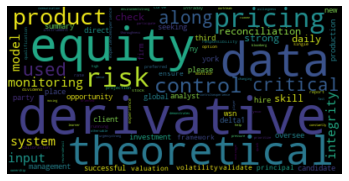


*** Field Application Engineer ***



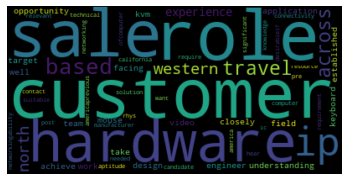


*** Field Data Scientist ***



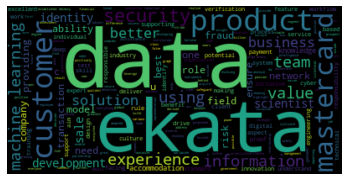


*** Fraud/Data Analyst  ***



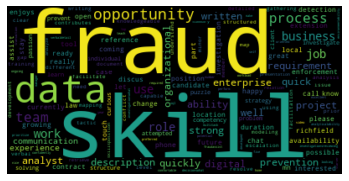


*** Freelance AWS Developer ***



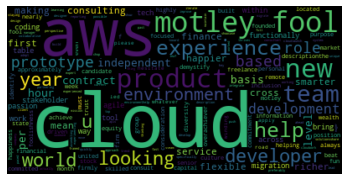


*** Front End Software Engineer ***



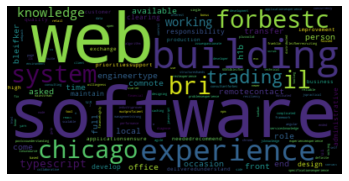


*** Front End Web Developer ***



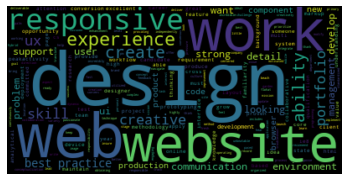


*** Front-end Software Engineer ***



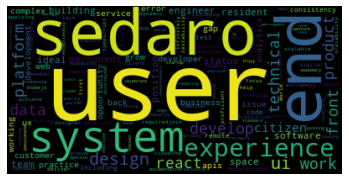


*** Frontend Software Engineer ***



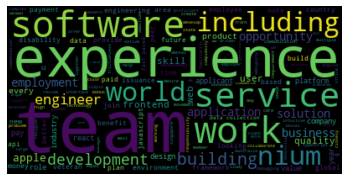


*** Frontend Software Engineering Intern ***



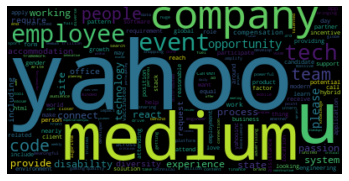


*** Frontend Software Engineering Intern - Spring (Attention Seniors + Masters Students!) ***



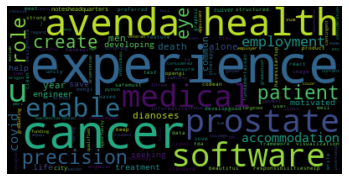


*** Frontend Software Engineering Intern - Summer 2023 ***



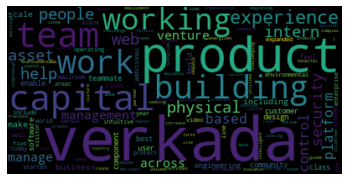


*** Frontend UI Software Engineer ***



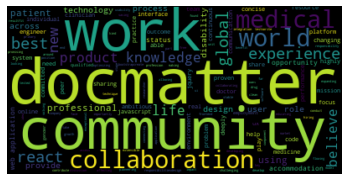


*** Full Stack Software Engineer ***



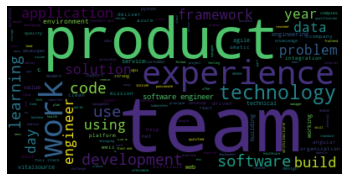


*** Full Stack Software Engineer (Internship) ***



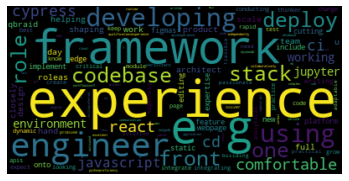


*** Full Stack Software Engineer - INTERNS (January OR Summer 2023) ***



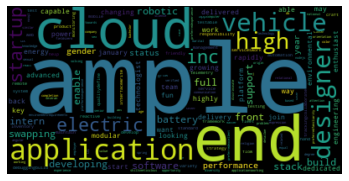


*** Full Stack Software Engineer Intern ***



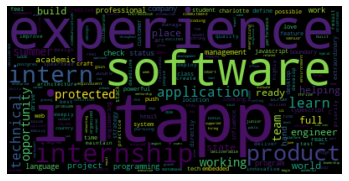


*** Full Stack Software Engineer Intern - Summer 2023 (Meraki) ***



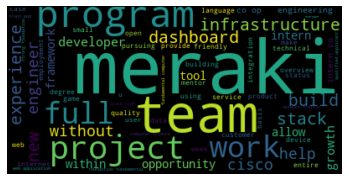


*** Full Stack Software Engineer-remote ***



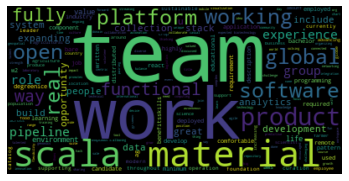


*** Full-Stack Software Engineer ***



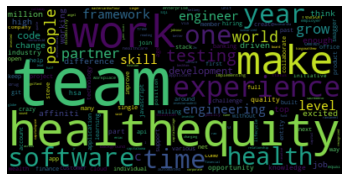


*** Fullstack Junior Software Engineer ***



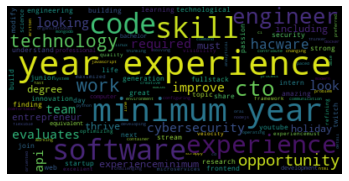


*** Fullstack Software Engineer ***



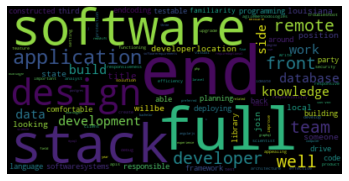


*** GCP DevOps Engineer ***



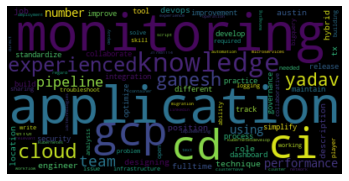


*** GCP Engineer ***



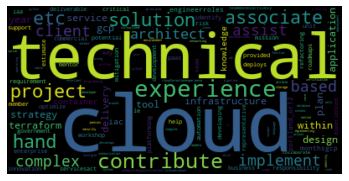


*** GCP Solution engineer ***



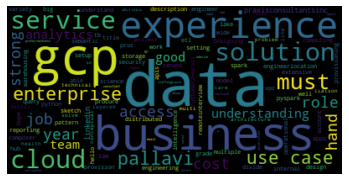


*** GitHub Actions Expert/DevOps - A4117 ***



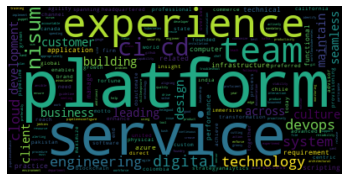


*** Graduate Intern - Machine Learning Engineer / Data Scientist ***



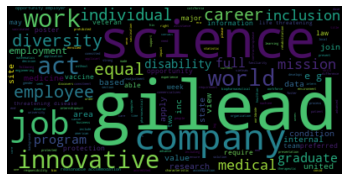


*** Graduate Level Internships ***



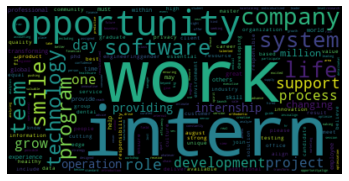


*** Graduate Web Developer ***



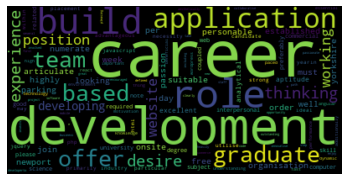


*** Hardware Qualification Engineer, Platforms, Google Cloud ***



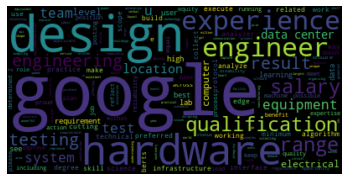


*** Health Care Data Analyst / Clinical Data Analyst @ SpectraMedix, East Windsor, New Jersey ***



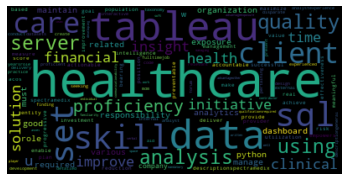


*** Healthcare Data Analyst ***



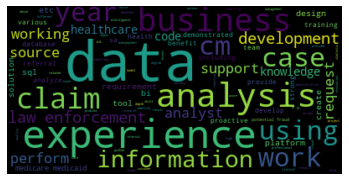


*** Healthcare Data Scientist ***



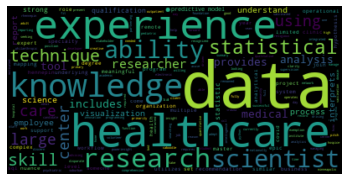


*** Healthcare Data Scientist  ***



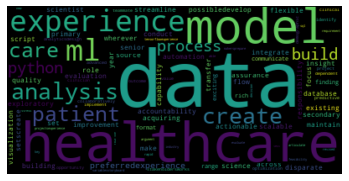


*** IAM Engineer ***



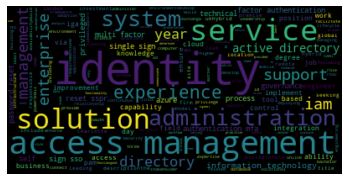


*** IAM Engineer  ***



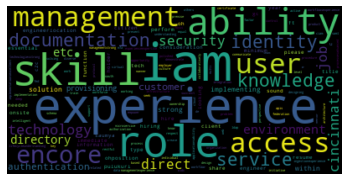


*** IAM Security Engineer ***



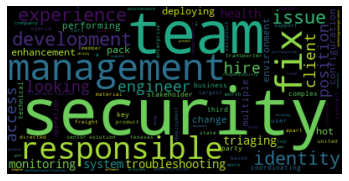


*** ISG Cloud DevOps Prgmr Analyst ***



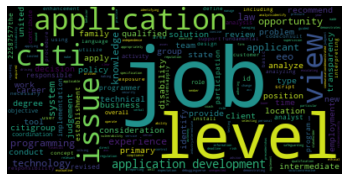


*** IT Data Analyst  ***



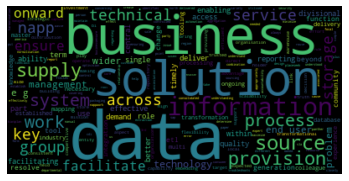


*** IT Intern ***



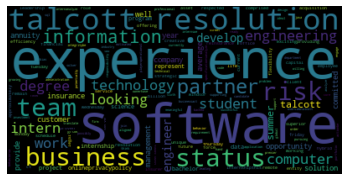


*** IT Intern: Compute Scaling Automation - 41957BR ***



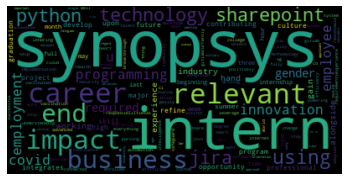


*** IT Software Engineer - Remote ***



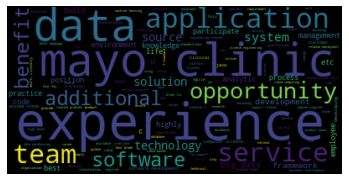


*** IT-Data Analyst - Quality Analyst ***



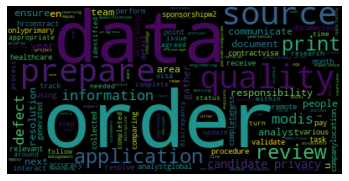


*** Information Technology Software Engineer I ***



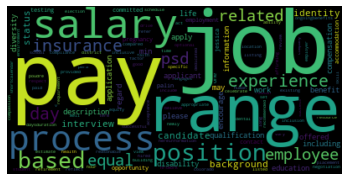


*** Infrastructure DevOps expert for an Agile AdTech ***



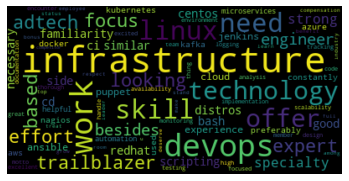


*** Insights Analyst ***



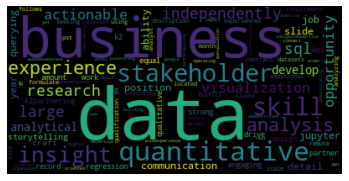


*** Integration Engineer ***



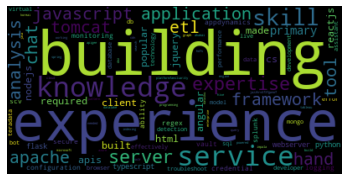


*** Interdisciplinary Data Scientist ***



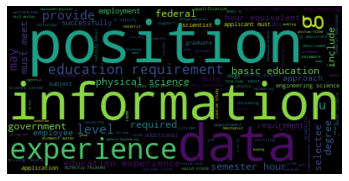


*** Intermediate Data Analyst ***



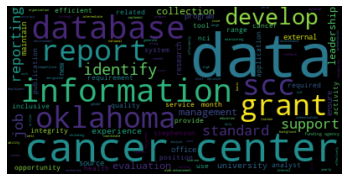


*** Intermediate Data Scientist 2 - Visualization ***



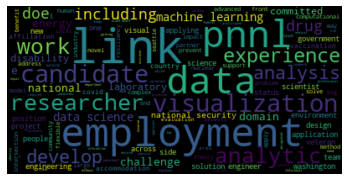


*** Intern - Data Scientist ***



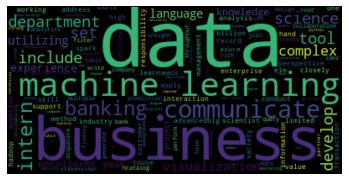


*** Intern - Data Scientist June 2023 ***



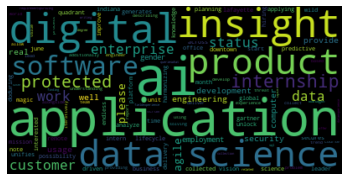


*** Intern - Junior Application Developer ***



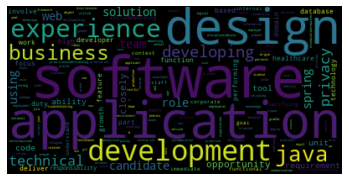


*** Intern - Software Application Development - Cloud Platforms ***



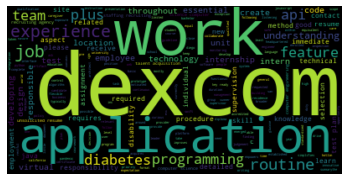


*** Intern - Software Developer ***



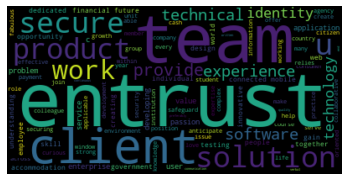


*** Intern - Software Development ***



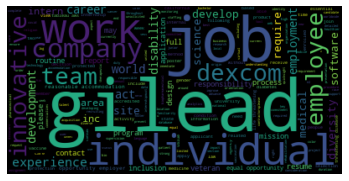


*** Intern - Software Development &amp; Engineering Design ***



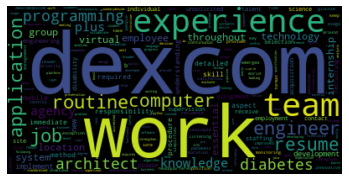


*** Intern - Software Engineer ***



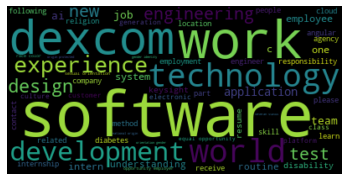


*** Intern - Software Engineer (NANE) ***



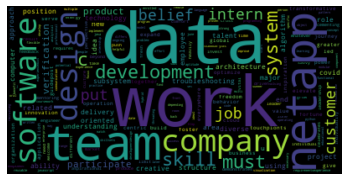


*** Intern - Software Engineer (NTD) ***



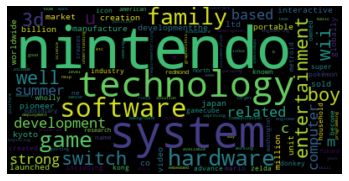


*** Intern - Software Engineer (PTC) ***



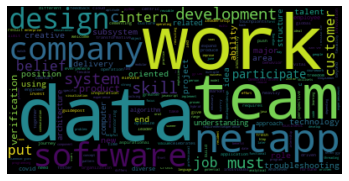


*** Intern - Software Engineer (SJC) ***



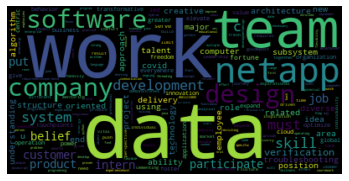


*** Intern - Software Engineer - Non Ed ***



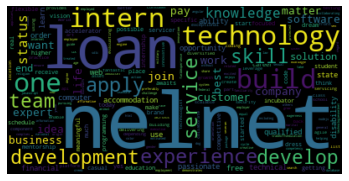


*** Intern - Software Engineering ***



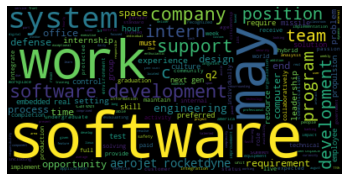


*** Intern - Software R&amp;D Data Engineer ***



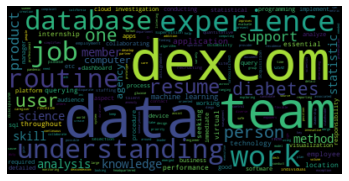


*** Intern - Software Tools Developer ***



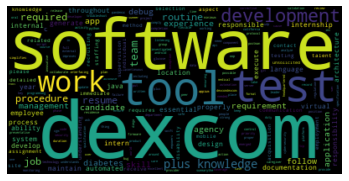


*** Intern Engineer ***



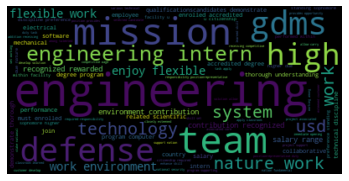


*** Intern Engineer - Software ***



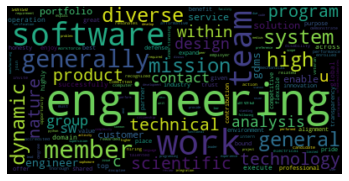


*** Intern Engineer - Software / Cyber Engineering - Remote Eligible ***



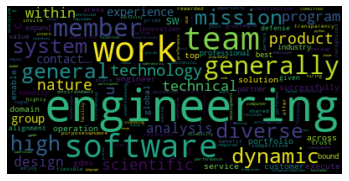


*** Intern Engineer - Software / Linux Developer ***



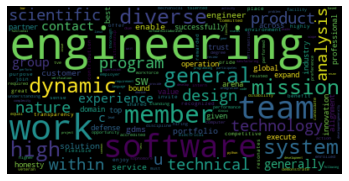


*** Intern, Data Engineer ***



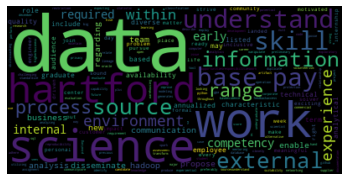


*** Intern, Data Scientist - IT ***



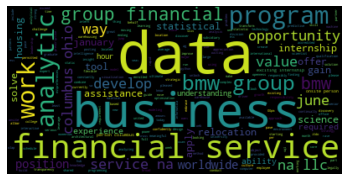


*** Intern, Global Engineering (Summer 2023) ***



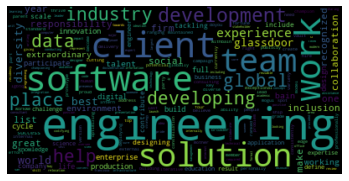


*** Intern, Information Technology ***



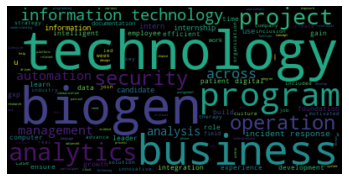


*** Intern, Software Development ***



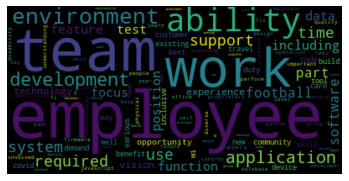


*** Intern, Software Engineer ***



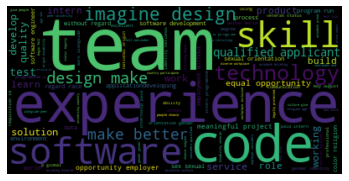


*** Intern, Software Engineer, Generalist ***



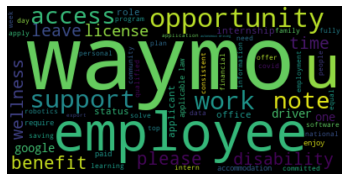


*** Intern, Software Engineering (Summer 2023) ***



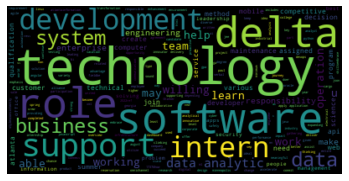


*** Intern, Software Tools Development Engineer ***



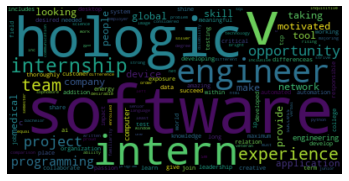


*** Intern- Cloud Engineering- SRE ***



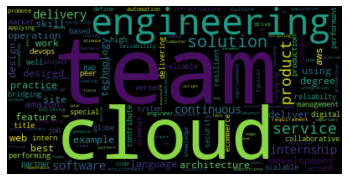


*** Intern: Software Engineer (Summer 2023) ***



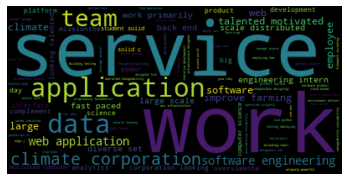


*** Interns- Software Development ***



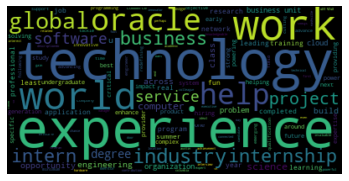


*** Internship - Software Engineer ***



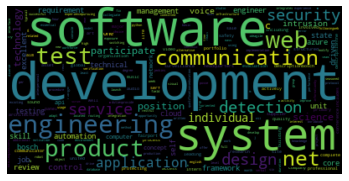


*** Internship - Software Engineering ***



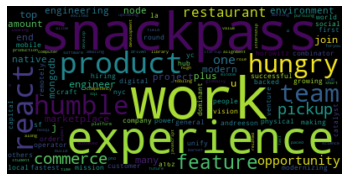


*** Internship Software Engineer Intern ***



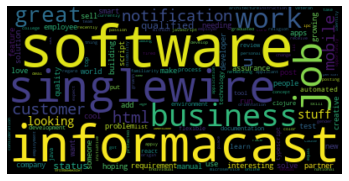


*** Investment Data Analyst ***



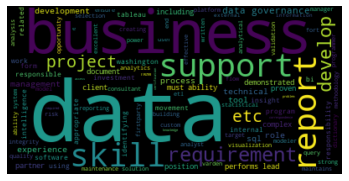


*** Java Software Development Engineer in Test ***



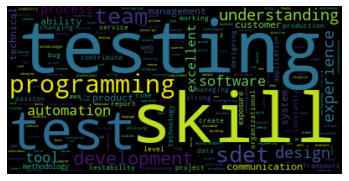


*** Java Software Engineer ***



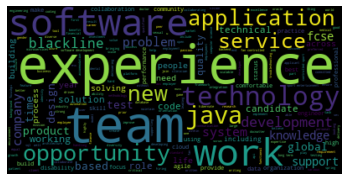


*** Jr Data Scientist  ***



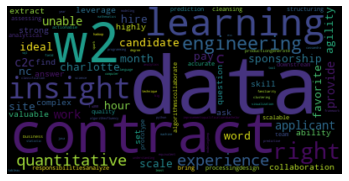


*** Jr Web Developer (React, JavaScript) ***



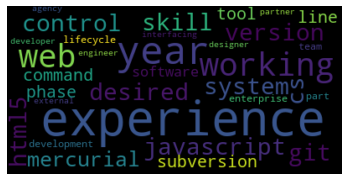


*** Jr. Data Analyst ***



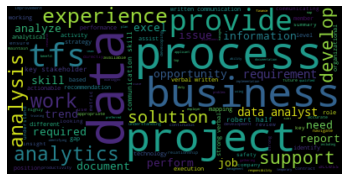


*** Jr. Data Scientist ***



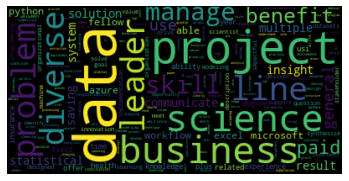


*** Jr. Security Engineer ***



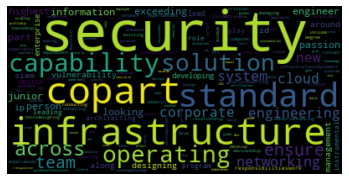


*** Jr. Site Reliability Engineer ***



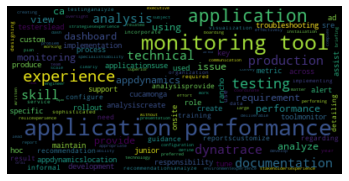


*** Jr. Software Developer, eCommerce Web ***



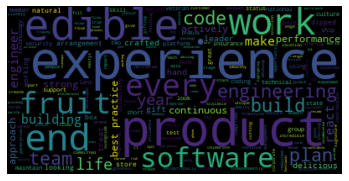


*** Jr. Software Engineer ***



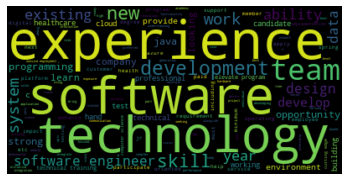


*** Jr. UHealth IT Data Scientist  ***



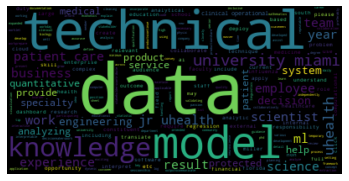


*** Jr.Machine Learning Engineer ***



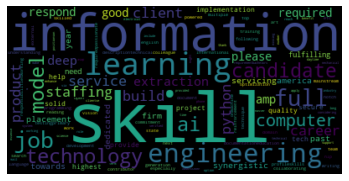


*** Junior AWS Cloud Developer ***



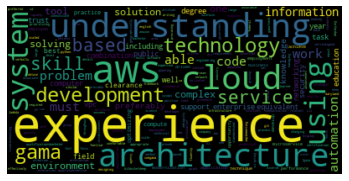


*** Junior Cloud/Infrastructure Engineer ***



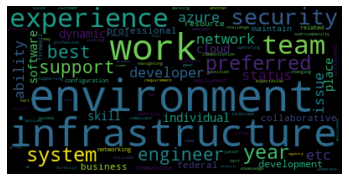


*** Junior Data Analyst ***



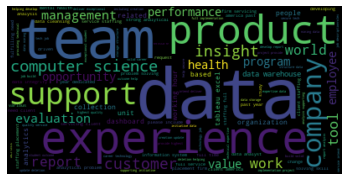


*** Junior Data Analyst  ***



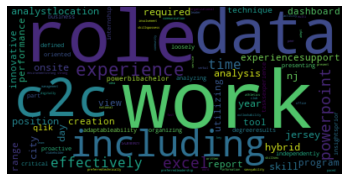


*** Junior Data Analyst (30-36 hours per week, part-time) ***



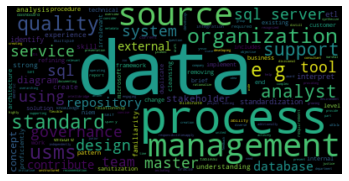


*** Junior Data Engineer ***



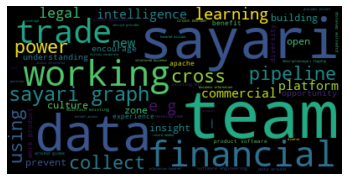


*** Junior Data Engineer  ***



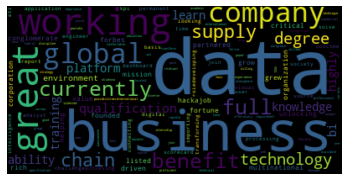


*** Junior Data Scientist ***



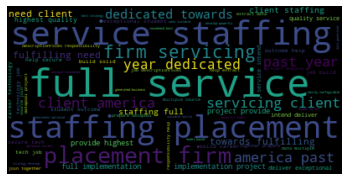


*** Junior Data Scientist (Data science and AI) ***



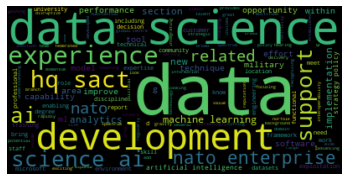

KeyboardInterrupt: ignored

In [ ]:
## Visualize data
jobs_list = aggregate.job_title.unique().tolist()
for job in jobs_list:

    # Start with one review:
    text = aggregate[aggregate.job_title == job].iloc[0].description
    # Create and generate a word cloud image:
    wordcloud = WordCloud().generate(text)
    print("\n***",job,"***\n")
    # Display the generated image:
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [ ]:
## Delete more stop words
other_stop_words = ['junior', 'senior','experience','etc','job','work','company','technique',
                    'candidate','skill','skills','language','menu','inc','new','plus','years',
                   'technology','organization','ceo','cto','account','manager','data','scientist','mobile',
                    'developer','product','revenue','strong']

job_df['description'] = job_df['description'].apply(lambda x: " ".join(x for x in x.split() if x not in other_stop_words))

In [319]:
locality_df = job_df[["job_locality","job_region"]].copy().reset_index()
locality_df = locality_df.groupby(["job_locality","job_region"]).agg({'index': tuple}).reset_index()
locality_df['index']= locality_df['index'].astype('str')
locality_df = locality_df.rename(columns = {'index':'job_id'})
locality_df

,job_locality,job_region,job_id
0,Aberdeen,MD,"(593, 1825)"
1,Ada,MI,"(1029,)"
2,Addison,TX,"(1662,)"
3,Alameda,CA,"(2147, 2238)"
4,Albany,NY,"(1076,)"
...,...,...,...
519,Windsor,CT,"(562,)"
520,Woburn,MA,"(1129,)"
521,Woodbridge,NJ,"(308, 1634)"
522,Worcester,MA,"(471, 810)"


In [ ]:
## Converting text to features 
vectorizer = TfidfVectorizer()
#Tokenize and build vocabulary
X = vectorizer.fit_transform(job_df.description)
y = job_df.job_title

# split data into 80% training and 20% job_df
X_train, X_job_df, y_train, y_job_df = train_test_split(X, y, test_size=0.2,random_state=109) 
print("train data shape: ",X_train.shape)
print("job_df data shape: ",X_job_df.shape)

# Fit model
clf = MultinomialNB()
clf.fit(X_train, y_train)
## Predict
y_predicted = clf.predict(X_job_df)

train data shape:  (1888, 30424)
job_df data shape:  (473, 30424)


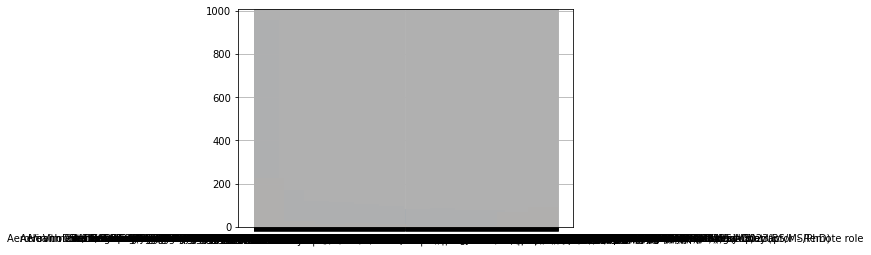

In [ ]:
y_train.hist()
y_job_df.hist()

In [ ]:
#evaluate the predictions
print("Accuracy score is: ",accuracy_score(y_job_df, y_predicted))
print("Classes: (to help read Confusion Matrix)\n", clf.classes_)
print("Confusion Matrix: ")

print(confusion_matrix(y_job_df, y_predicted))
print("Classification Report: ")
print(classification_report(y_job_df, y_predicted))

Accuracy score is:  0.21987315010570824
Classes: (to help read Confusion Matrix)
 [' AWS Devops with EKS(10+years must) -Onsite ' ' DATA ANALYST'
 ' DevOps with Python/Pulumi' ' Integration Engineer'
 ' Observability Engineer' ' Software Engineer- Backend (Remote)'
 '2023 Intern - Software Developer' '2023 Intern - Software Engineer'
 '2023 Intern - Software Engineer, Front End'
 '2023 Intern - Software Engineer, Machine Learning'
 '2023 Intern - Software Engineer, Mobile Development'
 '2023 Internship: Data Scientist'
 '2023 Summer Intern - Software Development'
 '2023 Summer Intern - Software Engineer [Slack]'
 '2023 Summer Intern - Software Engineer, US'
 '2023 Summer Intern Program Opportunities'
 '2023 Summer Internship - Cloud Engineer Intern Job'
 '2023 Summer Internship - Software Developer - Sales Tool Platform Intern Job'
 '2023 Summer Internship - Software Developer - Vehicle Software Delivery Intern Job'
 '2023 UberSTAR Internship Program - Data Science' 'AWS Cloud Develope

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
print(clf.coef_)
print(clf.coef_.shape)

[[-9.85152221 -9.85152221 -9.85152221 ... -9.85152221 -9.85152221
  -9.85152221]
 [-9.85180968 -9.85180968 -9.85180968 ... -9.85180968 -9.85180968
  -9.85180968]
 [-9.85167696 -9.85167696 -9.85167696 ... -9.85167696 -9.85167696
  -9.85167696]
 ...
 [-9.85198425 -9.85198425 -9.85198425 ... -9.85198425 -9.85198425
  -9.85198425]
 [-9.85160968 -9.85160968 -9.85160968 ... -9.85160968 -9.85160968
  -9.85160968]
 [-9.85176236 -9.85176236 -9.85176236 ... -9.85176236 -9.85176236
  -9.85176236]]
(1581, 18983)


/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:103: FutureWarning: Attribute `coef_` was deprecated in version 0.24 and will be removed in 1.1 (renaming of 0.26).
  warnings.warn(msg, category=FutureWarning)


In [ ]:
from textblob import TextBlob

nltk.download('averaged_perceptron_tagger')
technical_skills = ['python', 'c','r', 'c++','java','hadoop','scala','flask','pandas','spark','scikit-learn',
                    'numpy','php','sql','mysql','css','mongdb','nltk','fastai' , 'keras', 'pytorch','tensorflow',
                   'linux','Ruby','JavaScript','django','react','reactjs','ai','ui','tableau']
feature_array = vectorizer.get_feature_names()
# number of overall model features
features_numbers = len(feature_array)
## max sorted features number
n_max = int(features_numbers * 0.1)

##initialize output dataframe
output = pd.DataFrame()
for i in range(0,len(clf.classes_)):
    print("\n****" ,clf.classes_[i],"****\n")
    class_prob_indices_sorted = clf.feature_log_prob_[i, :].argsort()[::-1]
    raw_skills = np.take(feature_array, class_prob_indices_sorted[:n_max])
    print("list of unprocessed skills :")
    print(raw_skills)
    
    ## Extract technical skills
    top_technical_skills= list(set(technical_skills).intersection(raw_skills))[:6]
    #print("Top technical skills",top_technical_skills)
    
    ## Extract adjectives
    
    # Delete technical skills from raw skills list
    ## At this steps, raw skills list doesnt contain the technical skills
    #raw_skills = [x for x in raw_skills if x not in top_technical_skills]
    #raw_skills = list(set(raw_skills) - set(top_technical_skills))

    # transform list to string
    txt = " ".join(raw_skills)
    blob = TextBlob(txt)
    #top 6 adjective
    top_adjectives = [w for (w, pos) in TextBlob(txt).pos_tags if pos.startswith("JJ")][:6]
    #print("Top 6 adjectives: ",top_adjectives)
    
    output = output.append({'job_title':clf.classes_[i],
                        'technical_skills':top_technical_skills,
                        'soft_skills':top_adjectives },
                       ignore_index=True)

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)



****  AWS Devops with EKS(10+years must) -Onsite  ****

list of unprocessed skills :
['cicd' 'micro' 'cloudformation' ... 'economia' 'economic' 'economics']

****  DATA ANALYST ****

list of unprocessed skills :
['catalog' 'kpis' 'chain' ... 'ec2cdn' 'ec2s' 'eccles']

****  DevOps with Python/Pulumi ****

list of unprocessed skills :
['pulumi' 'gcp' 'administration' ... 'ecrc' 'ecr' 'ecosystemsdeep']

****  Integration Engineer ****

list of unprocessed skills :
['vari' 'boomi' 'end' ... 'elk' 'ellegourmet' 'elli']

****  Observability Engineer ****

list of unprocessed skills :
['spectraforce' 'observability' 'nahr' ... 'efficiently'
 'efficientlyexternal' 'efficientlyinterpersonal']

****  Software Engineer- Backend (Remote) ****

list of unprocessed skills :
['revolve' 'tomcat' 'finish' ... 'elasticsearchexperience'
 'elasticsearchknowledgeable' 'elaws']

**** 2023 Intern - Software Developer ****

list of unprocessed skills :
['adobe' 'behance' 'incentive' ... 'elegance' 'elegant'

In [190]:
output

,job_title,technical_skills,soft_skills
0,AWS Devops with EKS(10+years must) -Onsite,"[fastai, flask]","[native, vpc, ec2, developed, virtual, library]"
1,DATA ANALYST,"[fastai, flask]","[temple, lieu, indicator, accountable, measure..."
2,DevOps with Python/Pulumi,"[reactjs, java, python, fastai, flask, linux]","[spinnaker, owasp, continual, corrective, opti..."
3,Integration Engineer,"[fastai, mysql, django, sql]","[boomi, sap, doprimary, preferredsql, podssubs..."
4,Observability Engineer,"[fastai, django, linux, python]","[newjobphoria, iso, talent, principal, engagem..."
...,...,...,...
749,Vehicle Hardware - Silicon Development Enginee...,"[python, fastai, flask, linux, django]","[pcba, schematic, synthetic, gpu, plan, electr..."
750,Web Developer,"[reactjs, java, mysql, python, fastai, php]","[website, tak, drupal, general, wildlife, frie..."
751,data scientist - multiple openings,"[python, fastai, flask, sql, django]","[approachesas, determines, nontechnical, diges..."
752,lulu devops engAWS,"[fastai, flask]","[api7kafka7ci, boot8public, sql7rest, etcbonus..."


In [241]:


#job_new_df = pd.DataFrame(columns=["job_title","industry","company","description","job_locality","job_region","skills","job_post_expiry","education_requirements", "base_salary_min","base_salary_max","base_salary_currency","url"]) 
job_new_df = job_df.copy()
for j in job_new_df.index:
    for o in output.index:
        if(output.loc[o, 'job_title']==job_new_df.loc[j, 'job_title']):
            job_new_df.loc[j, 'skills'] = output.loc[o, 'technical_skills']



#job_new_df["skills"] = job_new_df["skills"].astype(str)
#job_new_df

In [ ]:
"""import numpy as np

lens = list(map(len, job_new_df['skills'].values))
print(lens)
res = pd.DataFrame({'job_title': np.repeat(
    job_new_df['job_title'], lens), 'skills': np.concatenate(job_new_df['skills'].values)})
res """

In [257]:
fnew_df = pd.DataFrame(columns=["job_title","industry","company","description","job_locality","job_region","skills","job_post_expiry","education_requirements", "base_salary_min","base_salary_max","base_salary_currency","url"]) 

#print(job_new_df.loc[i])
#fnew_df.loc[0]=job_new_df.loc[0]
c=0
for i in job_new_df.index:
    temp =job_new_df.loc[i,"skills"]
    for s in range(0,len(temp)):
        fnew_df.loc[c]=job_new_df.loc[i]
        fnew_df.loc[c, "skills"]=temp[s]
        c+=1

fnew_df

,job_title,industry,company,description,job_locality,job_region,skills,job_post_expiry,education_requirements,base_salary_min,base_salary_max,base_salary_currency,url
0,Data Scientist Internship,Radio and Television Broadcasting,iHeartMedia,\n\n\n iHeartMediaCurrent employees and...,Texas,United States,fastai,2022-12-20T17:38:56.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-scient...
1,Data Scientist Internship,Radio and Television Broadcasting,iHeartMedia,\n\n\n iHeartMediaCurrent employees and...,Texas,United States,django,2022-12-20T17:38:56.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-scient...
2,Data Scientist Internship,Radio and Television Broadcasting,iHeartMedia,\n\n\n iHeartMediaCurrent employees and...,Texas,United States,python,2022-12-20T17:38:56.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-scient...
3,Data Scientist Internship - OR (US),Insurance,Asurion,\n\n\n 2022-75202Asurion Data Science I...,Nashville,TN,ai,2023-01-04T03:56:32.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-scient...
4,Data Scientist Internship - OR (US),Insurance,Asurion,\n\n\n 2022-75202Asurion Data Science I...,Nashville,TN,fastai,2023-01-04T03:56:32.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-scient...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
11581,Data Analyst,IT Services and IT Consulting,SynergisticIT,\n\n\nAbout UsSynergistic IT is a full-service...,Lubbock,TX,python,2022-12-26T17:57:39.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-analys...
11582,Data Analyst,IT Services and IT Consulting,SynergisticIT,\n\n\nAbout UsSynergistic IT is a full-service...,Lubbock,TX,tableau,2022-12-26T17:57:39.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-analys...
11583,Data Analyst,IT Services and IT Consulting,SynergisticIT,\n\n\nAbout UsSynergistic IT is a full-service...,Lubbock,TX,ai,2022-12-26T17:57:39.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-analys...
11584,Market Data Analyst,Internet Publishing,S4 Market Data,\n\n\n Summary: PLEASE NOTE - This is N...,New York,NY,fastai,2022-12-22T05:30:35.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/market-data...


In [228]:
list_of_skills = [item for sublist in list(output['technical_skills']) for item in sublist]

unique_skills = set(list_of_skills)
skills_df = pd.DataFrame(list(unique_skills), 
                       columns=["skills"])

skills_df

,skills
0,tensorflow
1,reactjs
2,ui
3,nltk
4,ai
5,react
6,flask
7,hadoop
8,sql
9,java


In [335]:
for i in fnew_df.index:
    for j in skills_df.index:
        if(fnew_df.loc[i, "skills"]==skills_df.loc[j,"skills"]):
            fnew_df.loc[i, "skills"]=j
      

fnew_df

,job_id,job_id,job_title,industry,company,description,job_locality,job_region,skills,job_post_expiry,education_requirements,base_salary_min,base_salary_max,base_salary_currency,url
0,0,0,Data Scientist Internship,Radio and Television Broadcasting,iHeartMedia,\n\n\n iHeartMediaCurrent employees and...,Texas,United States,18,2022-12-20T17:38:56.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-scient...
1,1,1,Data Scientist Internship,Radio and Television Broadcasting,iHeartMedia,\n\n\n iHeartMediaCurrent employees and...,Texas,United States,20,2022-12-20T17:38:56.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-scient...
2,2,2,Data Scientist Internship,Radio and Television Broadcasting,iHeartMedia,\n\n\n iHeartMediaCurrent employees and...,Texas,United States,11,2022-12-20T17:38:56.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-scient...
3,3,3,Data Scientist Internship - OR (US),Insurance,Asurion,\n\n\n 2022-75202Asurion Data Science I...,Nashville,TN,4,2023-01-04T03:56:32.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-scient...
4,4,4,Data Scientist Internship - OR (US),Insurance,Asurion,\n\n\n 2022-75202Asurion Data Science I...,Nashville,TN,18,2023-01-04T03:56:32.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-scient...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11581,11581,11581,Data Analyst,IT Services and IT Consulting,SynergisticIT,\n\n\nAbout UsSynergistic IT is a full-service...,Lubbock,TX,11,2022-12-26T17:57:39.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-analys...
11582,11582,11582,Data Analyst,IT Services and IT Consulting,SynergisticIT,\n\n\nAbout UsSynergistic IT is a full-service...,Lubbock,TX,17,2022-12-26T17:57:39.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-analys...
11583,11583,11583,Data Analyst,IT Services and IT Consulting,SynergisticIT,\n\n\nAbout UsSynergistic IT is a full-service...,Lubbock,TX,4,2022-12-26T17:57:39.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/data-analys...
11584,11584,11584,Market Data Analyst,Internet Publishing,S4 Market Data,\n\n\n Summary: PLEASE NOTE - This is N...,New York,NY,18,2022-12-22T05:30:35.000Z,bachelor degree,,,,https://www.linkedin.com/jobs/view/market-data...


In [262]:
courses_df = pd.read_csv('/content/courses_data.csv' , keep_default_na=False)

print("Raw Data")
print(courses_df.head())

print("Data Shape")
print(courses_df.shape)


Raw Data
   Unnamed: 0                                              title    type  \
0           0   Accounting for Mergers and Acquisitions: Foun...  Course   
1           1                     Add Gore to Your Game in Unity  Course   
2           2         Add Ragdoll Effect to a Character in Unity  Course   
3           3   Advanced Topics in Derivative Pricing | Coursera  Course   
4           4                                                              

                                                 url  \
0  https://www.coursera.org/learn/accounting-for-...   
1  https://www.coursera.org/learn/add-gore-game-u...   
2  https://www.coursera.org/learn/ragdoll-effect-...   
3  https://www.coursera.org/learn/financial-engin...   
4                                                      

                                         description  \
0  This course aims at assisting you in interpret...   
1                                                      
2                            

In [263]:
courses_df.head()
courses_df.drop(columns = courses_df.columns[0], axis = 1, inplace= True)
courses_df = courses_df.dropna(how='all')

In [264]:
## Lower case
courses_df['description'] = courses_df['description'].apply(lambda x: " ".join(x.lower()for x in x.split()))
## remove tabulation and punctuation
courses_df['description'] = courses_df['description'].str.replace('[^\w\s]',' ')


#remove stop words
stop = stopwords.words('english')
courses_df['description'] = courses_df['description'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))

## lemmatization
courses_df['description'] = courses_df['description'].apply(lambda x: " ".join([Word(word).lemmatize() for word in x.split()]))

print("Preprocessed data: \n")
print(courses_df.head())

<ipython-input-264-cd6501213c7d>:4: FutureWarning: The default value of regex will change from True to False in a future version.
  courses_df['description'] = courses_df['description'].str.replace('[^\w\s]',' ')


Preprocessed data: 

                                               title    type  \
0   Accounting for Mergers and Acquisitions: Foun...  Course   
1                     Add Gore to Your Game in Unity  Course   
2         Add Ragdoll Effect to a Character in Unity  Course   
3   Advanced Topics in Derivative Pricing | Coursera  Course   
4                                                              

                                                 url  \
0  https://www.coursera.org/learn/accounting-for-...   
1  https://www.coursera.org/learn/add-gore-game-u...   
2  https://www.coursera.org/learn/ragdoll-effect-...   
3  https://www.coursera.org/learn/financial-engin...   
4                                                      

                                         description  \
0  course aim assisting interpreting financial ac...   
1                                                      
2                                                      
3  course discus topic derivative

In [269]:
courses_df

,title,type,url,description,skills,ratings,recent_views,enrolled
0,Accounting for Mergers and Acquisitions: Foun...,Course,https://www.coursera.org/learn/accounting-for-...,course aim assisting interpreting financial ac...,,,"9,141 recent views",
1,Add Gore to Your Game in Unity,Course,https://www.coursera.org/learn/add-gore-game-u...,,,,,
2,Add Ragdoll Effect to a Character in Unity,Course,https://www.coursera.org/learn/ragdoll-effect-...,,,,,
3,Advanced Topics in Derivative Pricing | Coursera,Course,https://www.coursera.org/learn/financial-engin...,course discus topic derivative pricing first m...,"['Implied Volatility', 'Synthetic Collateralis...",,"13,033 recent views","3,575 already enrolled"
4,,,,,,,,
...,...,...,...,...,...,...,...,...
1465,Audio Signal Processing for Music Applications...,Course,https://www.coursera.org/learn/audio-signal-pr...,course learn audio signal processing methodolo...,"['Digital Signal Processing', 'Signal Processi...",279 ratings,"23,332 recent views","50,718 already enrolled"
1466,Audio digital con Pure Data | Coursera,Course,https://www.coursera.org/learn/audio-digital-p...,en este curso aprenderã los principios del aud...,"['Additive Smoothing', 'Estimating Equations',...",36 ratings,"2,634 recent views","1,914 already enrolled"
1467,Audit System with Spring Boot AOP,Course,https://www.coursera.org/learn/audit-system-wi...,,,,,
1468,Auditing I: Conceptual Foundations of Auditing...,Course,https://www.coursera.org/learn/auditing-part1-...,course provides intensive conceptual applied i...,,468 ratings,"47,935 recent views","35,977 already enrolled"


In [291]:
courses_new_df = courses_df.copy()
courses_m_df = pd.DataFrame(columns=["title","type","url","description","ratings","recent_views","enrolled","skills"])
c=0

for j in courses_new_df.index:
    
    for o in skills_df.index:
        #print(o)
        skill = skills_df.loc[o, 'skills']
        if(skill in courses_new_df.loc[j, 'description']):
            #print(courses_new_df.loc[j, 'description'])
            #courses_new_df.loc[j, 'skills'] = skills_df.loc[o, 'skills']
            courses_m_df.loc[c]=courses_new_df.loc[j]
            courses_m_df.loc[c,"skills"]=o
            c+=1


courses_m_df

,title,type,url,description,ratings,recent_views,enrolled,skills
0,Accounting for Mergers and Acquisitions: Foun...,Course,https://www.coursera.org/learn/accounting-for-...,course aim assisting interpreting financial ac...,,"9,141 recent views",,4
1,Assisting Public Sector Decision Makers With ...,Course,https://www.coursera.org/learn/assist-public-s...,develop data analysis skill support public sec...,,"7,607 recent views",,2
2,Assisting Public Sector Decision Makers With ...,Course,https://www.coursera.org/learn/assist-public-s...,develop data analysis skill support public sec...,,"7,607 recent views",,4
3,AtenciÃ³n prehospitalaria del ictus agudo y s...,Course,https://www.coursera.org/learn/ictus-agudo-esc...,el ictus e una emergencia mã dica tiempo depen...,231 ratings,"3,625 recent views","4,251 already enrolled",2
4,AtenciÃ³n prehospitalaria del ictus agudo y s...,Course,https://www.coursera.org/learn/ictus-agudo-esc...,el ictus e una emergencia mã dica tiempo depen...,231 ratings,"3,625 recent views","4,251 already enrolled",14
...,...,...,...,...,...,...,...,...
1436,Attract and Engage Customers with Digital Mark...,Course,https://www.coursera.org/learn/attract-and-eng...,attract engage customer digital marketing seco...,"1,609 ratings","1,190,012 recent views","67,506 already enrolled",2
1437,Attract and Engage Customers with Digital Mark...,Course,https://www.coursera.org/learn/attract-and-eng...,attract engage customer digital marketing seco...,"1,609 ratings","1,190,012 recent views","67,506 already enrolled",4
1438,Attracting and Sourcing Diverse Candidates | C...,Course,https://www.coursera.org/learn/attracting-and-...,shortlisting interviewing process typically un...,,"1,750 recent views",,2
1439,Attracting and Sourcing Diverse Candidates | C...,Course,https://www.coursera.org/learn/attracting-and-...,shortlisting interviewing process typically un...,,"1,750 recent views",,4


In [ ]:
"""courses_new_df = pd.DataFrame(columns=["title","type","url","description","ratings","recent_views","enrolled"])

c=0
for i in range(0,5):#courses_df.index:
    #print(courses_df.loc[i])
    if(courses_df.loc[i,"skills"]):
        temp =courses_df.loc[i,"skills"]
        print(temp)
        for s in range(0,len(temp)):
            print(s)
            courses_new_df.loc[c]=courses_df.loc[i]
            courses_new_df.loc[c, "skills"]=temp[s]
            c+=1
    

#courses_new_df"""

In [ ]:
for i in courses_new_df.index:
    for j in skills_df.index:
        if(courses_new_df.loc[i, "skills"]==skills_df.loc[j,"skills"]):
            courses_new_df.loc[i, "skills"]=j
      

courses_new_df

In [ ]:
courses_df

,title,type,url,description,skills,ratings,recent_views,enrolled
0,Accounting for Mergers and Acquisitions: Foun...,Course,https://www.coursera.org/learn/accounting-for-...,course aim assisting interpreting financial ac...,,,"9,141 recent views",
1,Add Gore to Your Game in Unity,Course,https://www.coursera.org/learn/add-gore-game-u...,,,,,
2,Add Ragdoll Effect to a Character in Unity,Course,https://www.coursera.org/learn/ragdoll-effect-...,,,,,
3,Advanced Topics in Derivative Pricing | Coursera,Course,https://www.coursera.org/learn/financial-engin...,course discus topic derivative pricing first m...,"['Implied Volatility', 'Synthetic Collateralis...",,"13,033 recent views","3,575 already enrolled"
4,,,,,,,,
...,...,...,...,...,...,...,...,...
1465,Audio Signal Processing for Music Applications...,Course,https://www.coursera.org/learn/audio-signal-pr...,course learn audio signal processing methodolo...,"['Digital Signal Processing', 'Signal Processi...",279 ratings,"23,332 recent views","50,718 already enrolled"
1466,Audio digital con Pure Data | Coursera,Course,https://www.coursera.org/learn/audio-digital-p...,en este curso aprenderã los principios del aud...,"['Additive Smoothing', 'Estimating Equations',...",36 ratings,"2,634 recent views","1,914 already enrolled"
1467,Audit System with Spring Boot AOP,Course,https://www.coursera.org/learn/audit-system-wi...,,,,,
1468,Auditing I: Conceptual Foundations of Auditing...,Course,https://www.coursera.org/learn/auditing-part1-...,course provides intensive conceptual applied i...,,468 ratings,"47,935 recent views","35,977 already enrolled"


In [ ]:
skills_dict={}
for skill in output.technical_skills:
    for i in courses_df.index:
        if(skill in courses_df.loc["description"]):
            skills_dict.append()
courses_df['skills'] = skills_dict

In [146]:
conn = sqlite3.connect('MakeMyCareer_test.db')
cur = conn.cursor()

In [149]:
def run_query(query):
    return pd.read_sql(query,conn)

In [337]:
create_jobs_query="CREATE TABLE jobs(job_id int PRIMARY KEY NOT NULL UNIQUE, job_title VARCHAR(255), description VARCHAR,\
                            url VARCHAR, industry VARCHAR, company VARCHAR \
                            job_locality VARCHAR, job_region VARCHAR, skill VARCHAR, job_post_expiry date \
                            education_requirements VARCHAR, base_salary_max VARCHAR, base_salary_min VARCHAR\
                            base_salary_currency VARCHAR );"

cur.execute("DROP TABLE IF EXISTS jobs;")
cur.execute(create_jobs_query)

fnew_df.reset_index(inplace=True)
fnew_df = fnew_df.rename(columns = {'index':'job_id'})
fnew_df.to_sql('jobs',con=conn,index=False, if_exists='replace')

OperationalError: ignored

In [ ]:
query = "SELECT * FROM jobs"

run_query(query)

In [320]:
create_location_query="CREATE TABLE location(locality_id int PRIMARY KEY NOT NULL UNIQUE,\
                            locality VARCHAR, region VARCHAR, job_ids int, FOREIGN KEY (job_ids) REFERENCES jobs (job_id));"

cur.execute("DROP TABLE IF EXISTS jobs;")
cur.execute(create_jobs_query)


locality_df.reset_index(inplace=True)
locality_df = locality_df.rename(columns = {'level_0':'location_id'})
locality_df.to_sql('location',con=conn,index=False, if_exists='replace')

In [315]:
query = "SELECT * FROM location"

run_query(query)

,index,location_id,job_locality,job_region,job_id
0,0,0,Aberdeen,MD,"(593, 1825)"
1,1,1,Ada,MI,"(1029,)"
2,2,2,Addison,TX,"(1662,)"
3,3,3,Alameda,CA,"(2147, 2238)"
4,4,4,Albany,NY,"(1076,)"
...,...,...,...,...,...
519,519,519,Windsor,CT,"(562,)"
520,520,520,Woburn,MA,"(1129,)"
521,521,521,Woodbridge,NJ,"(308, 1634)"
522,522,522,Worcester,MA,"(471, 810)"


In [324]:
create_courses_query="CREATE TABLE courses(course_id int PRIMARY KEY NOT NULL UNIQUE, type VARCHAR, course_title VARCHAR(255), description VARCHAR,\
                            url VARCHAR, ratings VARCHAR, recent_views VARCHAR \
                            enrolled VARCHAR);"

cur.execute("DROP TABLE IF EXISTS courses;")
cur.execute(create_courses_query)
#"title","type","url","description","ratings","recent_views","enrolled"
courses_m_df.reset_index(inplace=True)
courses_m_df = courses_m_df.rename(columns = {'index':'course_id'})
courses_m_df.to_sql('courses',con=conn,index=False, if_exists='replace')

In [325]:
query = "SELECT * FROM courses"

run_query(query)

,course_id,id,title,type,url,description,ratings,recent_views,enrolled,skills
0,0,0,Accounting for Mergers and Acquisitions: Foun...,Course,https://www.coursera.org/learn/accounting-for-...,course aim assisting interpreting financial ac...,,"9,141 recent views",,4
1,1,1,Assisting Public Sector Decision Makers With ...,Course,https://www.coursera.org/learn/assist-public-s...,develop data analysis skill support public sec...,,"7,607 recent views",,2
2,2,2,Assisting Public Sector Decision Makers With ...,Course,https://www.coursera.org/learn/assist-public-s...,develop data analysis skill support public sec...,,"7,607 recent views",,4
3,3,3,AtenciÃ³n prehospitalaria del ictus agudo y s...,Course,https://www.coursera.org/learn/ictus-agudo-esc...,el ictus e una emergencia mã dica tiempo depen...,231 ratings,"3,625 recent views","4,251 already enrolled",2
4,4,4,AtenciÃ³n prehospitalaria del ictus agudo y s...,Course,https://www.coursera.org/learn/ictus-agudo-esc...,el ictus e una emergencia mã dica tiempo depen...,231 ratings,"3,625 recent views","4,251 already enrolled",14
...,...,...,...,...,...,...,...,...,...,...
1436,1436,1436,Attract and Engage Customers with Digital Mark...,Course,https://www.coursera.org/learn/attract-and-eng...,attract engage customer digital marketing seco...,"1,609 ratings","1,190,012 recent views","67,506 already enrolled",2
1437,1437,1437,Attract and Engage Customers with Digital Mark...,Course,https://www.coursera.org/learn/attract-and-eng...,attract engage customer digital marketing seco...,"1,609 ratings","1,190,012 recent views","67,506 already enrolled",4
1438,1438,1438,Attracting and Sourcing Diverse Candidates | C...,Course,https://www.coursera.org/learn/attracting-and-...,shortlisting interviewing process typically un...,,"1,750 recent views",,2
1439,1439,1439,Attracting and Sourcing Diverse Candidates | C...,Course,https://www.coursera.org/learn/attracting-and-...,shortlisting interviewing process typically un...,,"1,750 recent views",,4


In [326]:
create_skills_query="CREATE TABLE skills(skill_id int PRIMARY KEY NOT NULL UNIQUE, skills VARCHAR);"

cur.execute("DROP TABLE IF EXISTS skills;")
cur.execute(create_skills_query)
#"title","type","url","description","ratings","recent_views","enrolled"

skills_df.reset_index(inplace=True)
skills_df = skills_df.rename(columns = {'index':'skill_id'})
skills_df.to_sql('skills',con=conn, if_exists='replace')

In [332]:
query = "SELECT * FROM skills"

run_query(query)

,index,skill_id,id,skills
0,0,0,0,tensorflow
1,1,1,1,reactjs
2,2,2,2,ui
3,3,3,3,nltk
4,4,4,4,ai
5,5,5,5,react
6,6,6,6,flask
7,7,7,7,hadoop
8,8,8,8,sql
9,9,9,9,java


Use Cases:

1. Find skills required for a Data Analyst Job Position
2. Find courses for my job position
3. Find jobs for set of skills in user's profile
4. How many paid courses are available on AI which provide a certificate?
5. Which is the most trending course on Natural Language Processing?



In [330]:
query1 = "SELECT * FROM skills \
               INNER JOIN jobs ON jobs.skills=skills.skill_id \
              where jobs.job_title = 'Data Analyst' "
query2 = "SELECT * FROM courses \
               INNER JOIN skills ON skills.skill_id=courses.skills \
               INNER JOIN jobs ON skills.skill_id=jobs.skills \
              where jobs.job_title = 'Data Analyst' "
query3 = "SELECT * FROM jobs \
               INNER JOIN jobs ON jobs.skills=skills.skill_id \
              where skills.skill = 'ai' "
query4 = "SELECT * FROM courses \
               INNER JOIN jobs ON courses.skills=skills.skill_id \
              where skills.skill = 'ai' "
query5 = "SELECT * FROM courses \
               INNER JOIN jobs ON courses.skills=skills.skill_id \
              where skills.skill = 'ai' ORDER BY ratings DESC LIMIT 1"
run_query(query1)

DatabaseError: ignored